<a href="https://colab.research.google.com/github/Kusakawama/MADS_CNN/blob/main/POC_WF_SZ.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Masterthesis: Exploring the Use of Explainable AI for Decision Making in the Context of Disaster Risk Management for Wildfires. **POC: TCAV for Wildfire Occurence Prediction**
---
Sarah S. Ziegenhagen


## Library Installations and Imports

In [ ]:
# Install necessary packages
! pip install -q kaggle
! pip install captum
! pip install torch torchvision
! pip install tensorboard
! pip install torchcam
! pip install lime

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 683.6 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 1.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=25d016de3cd6a12b31131423872558647ebc546ce77b56f01a2da24f8ef0d070
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
# General library imports
import numpy as np
import os, glob
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind
from google.colab import files
import cv2
import random
import shutil
from PIL import Image
from sklearn.metrics import confusion_matrix
import itertools
from lime import lime_image
import pandas as pd
import seaborn as sns

# Pytorch and TorchCAM imports for deep learning and model explanations
import torch
#import torchvision
from torch.utils.data import IterableDataset, DataLoader
from torchcam.utils import overlay_mask
import torch.nn as nn
import torchvision.models as models
from torchvision.io import read_image
import torch.optim as optim
from torchvision import datasets, models, transforms
from torchvision.datasets import ImageFolder
from torchcam.methods import GradCAM
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter()

# Captum imports for model interpretability and concept-based attribution
from captum.attr import LayerGradientXActivation, LayerIntegratedGradients
from captum.concept import TCAV
from captum.concept import Concept
from captum.concept._utils.data_iterator import dataset_to_dataloader, CustomIterableDataset
from captum.concept._utils.common import concepts_to_str

## Device Setup and Configuration

In [ ]:
# Specify the device as CPU, as the current TCAV implementation does not support GPU.
# Note: Code tested and run on Google Colab T4 V2 environment.
device = torch.device("cpu")
print("Using device:", device)

Using device: cpu


# Wildfire Occurence Classification Model

## Wildfire Data Loading and Preprocessing

In [ ]:
# Connect to Kaggle API to authenticate and load the required datasets.
# Requires 'kaggle.json' for API access.
files.upload()
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets list

Saving kaggle.json to kaggle.json
ref                                                                  title                                           size  lastUpdated          downloadCount  voteCount  usabilityRating  
-------------------------------------------------------------------  ---------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
haseebindata/student-performance-predictions                         Student Performance Predictions                  9KB  2024-08-17 06:57:57           7976        169  0.9411765        
karunyaronith/time-series-financial-portfolio-data                   Time series Stock Price dataset                  4KB  2024-09-03 05:31:12            809         23  1.0              
stefanydeoliveira/summer-olympics-medals-1896-2024                   Summer Olympics Medals (1896-2024)               4MB  2024-08-29 23:52:10           1540         34  1.0              
lainguyn123/student-perfor

In [ ]:
# download and unzip the wildfire occurence dataset
! kaggle datasets download abdelghaniaaba/wildfire-prediction-dataset
! mkdir -p wildfire-prediction-dataset
! unzip wildfire-prediction-dataset.zip -d wildfire-prediction-dataset

Streaming output truncated to the last 5000 lines.
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.465183,45.443641.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.465388,45.584881.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.469451,45.480331.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.471252,45.51974.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.472693,45.427766.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.473015,45.435254.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.475051,45.56612.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.477079,45.597274.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.478813,45.555686.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.479478,45.524618.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.480135,45.528248.jpg  
  inflating: wil

In [ ]:
# download and unzip the landuse-concept dataset
! kaggle datasets download apollo2506/landuse-scene-classification
! mkdir -p concept-dataset
! unzip landuse-scene-classification.zip -d concept-dataset

Streaming output truncated to the last 5000 lines.
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000365.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000366.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000367.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000368.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000369.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000371.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000372.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000374.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000376.p

In [ ]:
# Investigate the dataset to gather image counts
# and size distributions across train, test, and validation sets.

wildfire_dir = "/content/wildfire-prediction-dataset"
folder_image_count = {}
image_sizes = {}

# List of subfolders (train, test, valid) to investigate.
subfolders = ["train", "test", "valid"]

# Iterate through each subfolder and gather image statistics.
for subfolder in subfolders:
    subfolder_path = os.path.join(wildfire_dir, subfolder)
    folder_image_count[subfolder] = 0

    # Iterate through each folder (concept) within the subfolder
    for folder_name in os.listdir(subfolder_path):
        folder_path = os.path.join(subfolder_path, folder_name)
        if os.path.isdir(folder_path):
            for image_name in os.listdir(folder_path):
                image_path = os.path.join(folder_path, image_name)
                try:
                    with Image.open(image_path) as img:
                        img_size = img.size
                        folder_image_count[subfolder] += 1
                        if img_size not in image_sizes:
                            image_sizes[img_size] = 0
                        image_sizes[img_size] += 1
                except Exception as e:
                    print(f"Error loading image {image_path} in {subfolder}/{folder_name}: {e}")

# Print the results
print("Image counts by subfolder:", folder_image_count)
print("Image sizes frequency:", image_sizes)

Image counts by subfolder: {'train': 30250, 'test': 6300, 'valid': 6300}
Image sizes frequency: {(350, 350): 42850}


In [ ]:
# Define the paths to the wildfire data
train_dir = "/content/wildfire-prediction-dataset/train"
val_dir = "/content/wildfire-prediction-dataset/valid"
test_dir = "/content/wildfire-prediction-dataset/test"

Image: /content/wildfire-prediction-dataset/train/wildfire/-79.5051,48.18375.jpg
Image: /content/wildfire-prediction-dataset/train/wildfire/-76.8618,54.3859.jpg
Image: /content/wildfire-prediction-dataset/train/wildfire/-76.85794,48.81565.jpg
Image: /content/wildfire-prediction-dataset/train/wildfire/-77.35459,48.20983.jpg
Image: /content/wildfire-prediction-dataset/train/wildfire/-68.59579,50.6247.jpg
Image: /content/wildfire-prediction-dataset/train/nowildfire/-73.538678,45.576637.jpg
Image: /content/wildfire-prediction-dataset/train/nowildfire/-114.057975,51.002928.jpg
Image: /content/wildfire-prediction-dataset/train/nowildfire/-114.150412,50.897904.jpg
Image: /content/wildfire-prediction-dataset/train/nowildfire/-79.458965,43.673094.jpg
Image: /content/wildfire-prediction-dataset/train/nowildfire/-73.440105,45.513211.jpg


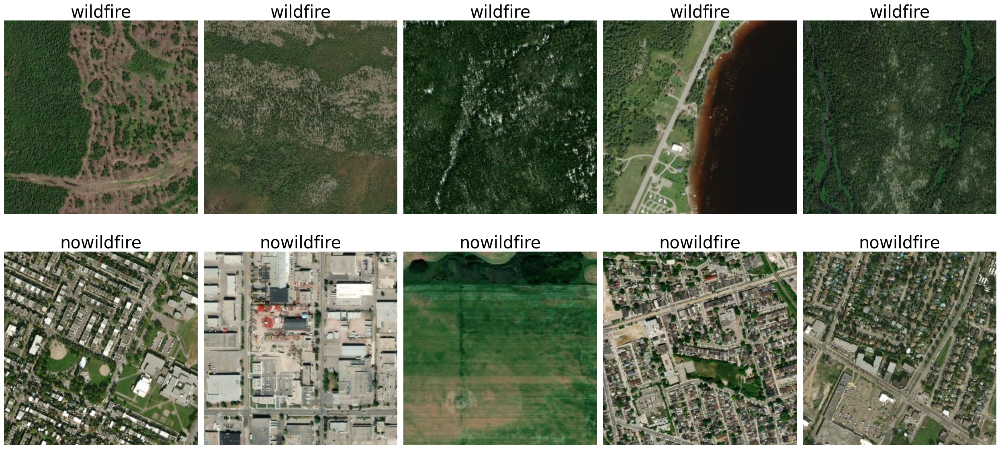

In [ ]:
# Display a sample of images for each class (wildfire, nowildfire) from the training dataset.

class_names = ["wildfire", "nowildfire"]
image_count = 5

# Create subplots for visualizing the images.
fig, axs = plt.subplots(2, image_count, figsize=(25, 12))
plt.subplots_adjust(hspace=0.3)

# Loop through each class and display a subset of images.
for row, class_name in enumerate(class_names):
    class_folder = os.path.join(train_dir, class_name)
    image_files = glob.glob(os.path.join(class_folder, '*.*'))[:image_count]

    for col, image_file in enumerate(image_files):
        img = plt.imread(image_file)
        axs[row, col].imshow(img)
        axs[row, col].axis('off')
        axs[row, col].set_title(class_name, fontsize=30)
        print(f"Image: {image_file}")

plt.tight_layout()
plt.show()

In [ ]:
# Define a data loader using CV2
def cv2_loader(path):
  """
  Loads an image from the specified path using OpenCV and converts it to RGB format.
  Args:
      path (str): The path to the image file.
  Returns:
      PIL.Image: The loaded and converted image.
  """
  img = cv2.imread(path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  return Image.fromarray(img)

In [ ]:
# Define data transformations to resize, normalize, and convert images to tensors.
# Standard mean and std from ImageNet are used for normalization, matching the pre-trained model requirements.
data_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [ ]:
# Load the train, validation, and test datasets, applying the defined transformations using the custom CV2 loader.
# Datasets are loaded into PyTorch DataLoader for batching and shuffling.

# Load training data
train_dataset = ImageFolder(root=train_dir, transform=data_transforms, loader=cv2_loader)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

# Load validation data
val_dataset = ImageFolder(root=val_dir, transform=data_transforms, loader=cv2_loader)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

# Load test data
test_dataset = ImageFolder(root=test_dir, transform=data_transforms, loader=cv2_loader)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

## Model Training

In [ ]:
# Initialize the pretrained ResNet50 model, which has been pre-trained on the ImageNet dataset.
model = models.resnet50(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 197MB/s]


In [ ]:
# Modify the fully connected layer for binary classification (wildfire, nowildfire).
model.fc = nn.Linear(model.fc.in_features, 2)

In [ ]:
# Define the hyperparameters for model training.
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
num_epochs = 10

In [ ]:
def train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs, writer):
  """
  Trains a PyTorch model using the provided training and validation data loaders.
      Args:
        model: The neural network model to train.
        criterion: The loss function.
        optimizer: The optimizer for updating model weights.
        train_loader: DataLoader for the training data.
        val_loader: DataLoader for the validation data.
        num_epochs: Number of epochs to train the model.
        writer: TensorBoard writer for logging training metrics.
  """
  device = "cpu"
  model = model.to(device)

  for epoch in range(num_epochs):
    # Training phase
    model.train()
    running_loss = 0.0
    correct_train = 0
    total_train = 0

      # Iterate over training data
      for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        _, preds = torch.max(outputs, 1)
        correct_train += (preds == labels).sum().item()
        total_train += labels.size(0)

      epoch_loss = running_loss / len(train_loader)
      epoch_acc = correct_train / total_train

      # Validation phase after each epoch
      model.eval()
      correct_val = 0
      total_val = 0
      running_val_loss = 0.0

      # Iterate over validation data
      with torch.no_grad():
        for inputs, labels in val_loader:
          inputs, labels = inputs.to(device), labels.to(device)
          outputs = model(inputs)
          loss = criterion(outputs, labels)
          running_val_loss += loss.item()
          _, preds = torch.max(outputs, 1)
          correct_val += (preds == labels).sum().item()
          total_val += labels.size(0)

      epoch_val_loss = running_val_loss / len(val_loader)
      epoch_val_acc = correct_val / total_val

      # Log validation loss and accuracy
      writer.add_scalars("Loss", {"Train_loss": epoch_loss,"Val_loss": epoch_val_loss}, epoch)
      writer.add_scalars("Accuracy", {"Train_accuracy": epoch_acc, "Val_accuracy": epoch_val_acc}, epoch)

      print(f"Epoch {epoch+1}/{num_epochs}, "
            f"Train Loss: {epoch_loss:.4f}, Train Acc: {epoch_acc:.4f}, "
            f"Val Loss: {epoch_val_loss:.4f}, Val Acc: {epoch_val_acc:.4f}")

In [ ]:
def plot_confusion_matrix(cm, classes, normalize=False, title="Confusion matrix", cmap=plt.cm.Blues):
  """
  Plots the confusion matrix for model evaluation.
  Args:
    cm (numpy.ndarray): The confusion matrix.
    classes (list): List of class labels.
    normalize (bool): If True, normalize the confusion matrix.
    title (str): Title for the plot.
    cmap: Colormap for the confusion matrix.
  """
  if normalize:
    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    print("Normalized confusion matrix")
  else:
      print("Confusion matrix, without normalization")

  plt.figure(figsize=(6,6))
  plt.imshow(cm, interpolation="nearest", cmap=cmap)
  plt.title(title)
  plt.colorbar()
  tick_marks = np.arange(len(classes))
  plt.xticks(tick_marks, classes, rotation=45)
  plt.yticks(tick_marks, classes)

  fmt = ".2f" if normalize else "d"
  thresh = cm.max() / 2.
  for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
    plt.text(j, i, format(cm[i, j], fmt),
              horizontalalignment="center",
              color="white" if cm[i, j] > thresh else "black")

  plt.tight_layout()
  plt.ylabel("True label")
  plt.xlabel("Predicted label")

In [ ]:
# Train the model using the defined parameters:
# model, criterion, optimizer, data loaders, number of epochs, and TensorBoard writer.
train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs, writer)

Epoch 1/10, Train Loss: 0.1479, Train Acc: 0.9457, Val Loss: 0.0885, Val Acc: 0.9670
Epoch 2/10, Train Loss: 0.1000, Train Acc: 0.9643, Val Loss: 0.1102, Val Acc: 0.9594
Epoch 3/10, Train Loss: 0.0807, Train Acc: 0.9709, Val Loss: 0.2458, Val Acc: 0.8943
Epoch 4/10, Train Loss: 0.0672, Train Acc: 0.9762, Val Loss: 0.0874, Val Acc: 0.9711
Epoch 5/10, Train Loss: 0.0605, Train Acc: 0.9782, Val Loss: 0.0969, Val Acc: 0.9632
Epoch 6/10, Train Loss: 0.0576, Train Acc: 0.9804, Val Loss: 0.0784, Val Acc: 0.9727
Epoch 7/10, Train Loss: 0.0507, Train Acc: 0.9822, Val Loss: 0.1180, Val Acc: 0.9581
Epoch 8/10, Train Loss: 0.0502, Train Acc: 0.9823, Val Loss: 0.0724, Val Acc: 0.9743
Epoch 9/10, Train Loss: 0.0459, Train Acc: 0.9840, Val Loss: 0.4123, Val Acc: 0.8465
Epoch 10/10, Train Loss: 0.0408, Train Acc: 0.9859, Val Loss: 0.0770, Val Acc: 0.9735


For future reference, original training output:

Epoch 1/10, Train Loss: 0.1479, Train Acc: 0.9457, Val Loss: 0.0885, Val Acc: 0.9670

Epoch 2/10, Train Loss: 0.1000, Train Acc: 0.9643, Val Loss: 0.1102, Val Acc: 0.9594

Epoch 3/10, Train Loss: 0.0807, Train Acc: 0.9709, Val Loss: 0.2458, Val Acc: 0.8943

Epoch 4/10, Train Loss: 0.0672, Train Acc: 0.9762, Val Loss: 0.0874, Val Acc: 0.9711

Epoch 5/10, Train Loss: 0.0605, Train Acc: 0.9782, Val Loss: 0.0969, Val Acc: 0.9632

Epoch 6/10, Train Loss: 0.0576, Train Acc: 0.9804, Val Loss: 0.0784, Val Acc: 0.9727

Epoch 7/10, Train Loss: 0.0507, Train Acc: 0.9822, Val Loss: 0.1180, Val Acc: 0.9581

Epoch 8/10, Train Loss: 0.0502, Train Acc: 0.9823, Val Loss: 0.0724, Val Acc: 0.9743

Epoch 9/10, Train Loss: 0.0459, Train Acc: 0.9840, Val Loss: 0.4123, Val Acc: 0.8465

Epoch 10/10, Train Loss: 0.0408, Train Acc: 0.9859, Val Loss: 0.0770, Val Acc: 0.9735

### TensorBoard Visualisation

In [ ]:
# Ensure that all the pending events are written to the TensorBoard logs.
writer.flush()

In [ ]:
# Close the TensorBoard writer to release resources.
writer.close()

In [ ]:
# Enable inline plotting for Matplotlib in Jupyter notebooks (required for TensorBoard visualizations to display correctly).
%matplotlib inline

In [ ]:
# Load the TensorBoard extension to enable TensorBoard within the notebook environment.
%load_ext tensorboard

In [ ]:
# Launch TensorBoard to visualize logs from the 'runs' directory.
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

### Evaluation

In [ ]:
# Evaluate the trained model using the test dataset and calculate the accuracy.
model.eval()
correct = 0
total = 0
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        correct += (preds == labels).sum().item()
        total += labels.size(0)

print(f"Test Accuracy: {correct/total * 100:.2f}%")

Test Accuracy: 98.16%


In [ ]:
# Save the trained model's state to a file for use across sessions.
torch.save(model.state_dict(), "resnet50_torch_wfclassification.pth")

# Download the saved model file to the local machine.
files.download("/content/resnet50_torch_wfclassification.pth")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Confusion matrix, without normalization


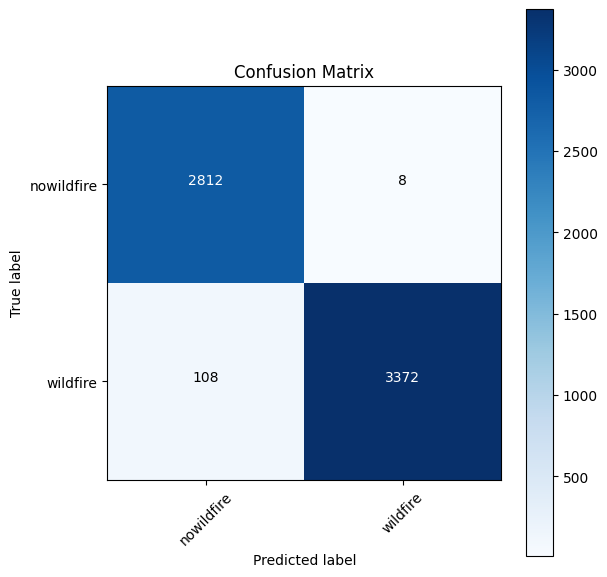

In [ ]:
# Generate predictions for the test data and collect true labels and predictions.
# Then, compute and display the confusion matrix.
model.eval()
all_preds = []
all_labels = []

with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        all_preds.extend(preds.numpy())
        all_labels.extend(labels.numpy())

# Compute confusion matrix and plot it
cm = confusion_matrix(all_labels, all_preds)
plot_confusion_matrix(cm, classes=["nowildfire", "wildfire"], title="Confusion Matrix")

## Model Loading

In [ ]:
# Load the trained ResNet50 model.
# Reinitialize the ResNet50 architecture and update the final layer for binary classification.
model_loaded = models.resnet50(pretrained=False)
model_loaded.fc = nn.Linear(model_loaded.fc.in_features, 2)

# Load the previously saved weights into the model.
model_loaded.load_state_dict(torch.load("/content/resnet50_torch_wfclassification.pth", map_location=torch.device("cpu"), weights_only=True))

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


<All keys matched successfully>

In [ ]:
# Evaluate the loaded model on the test data to confirm it behaves as expected.
# The test accuracy should match the original evaluation (98.16%).
model_loaded.eval()
correct = 0
total = 0
with torch.no_grad():
  for inputs, labels in test_loader:
    inputs, labels = inputs.to(device), labels.to(device)
    outputs = model_loaded(inputs)
    _, preds = torch.max(outputs, 1)
    correct += (preds == labels).sum().item()
    total += labels.size(0)

print(f"Test Accuracy: {correct/total * 100:.2f}%")

Test Accuracy: 98.16%


## Investigate Misclassified Images

In [ ]:
class ImageFolderWithPaths(ImageFolder):
  """
  Custom dataset that includes image file paths. Extends torchvision.datasets.ImageFolder.
  """
  # Override the __getitem__ method to also return the image file path
  def __getitem__(self, index):
    # Get the original tuple (image, label)
    original_tuple = super(ImageFolderWithPaths, self).__getitem__(index)

    # The image file path
    path = self.imgs[index][0]

    # Return a new tuple that includes the path
    return original_tuple + (path,)

In [ ]:
# Load the test dataset using the custom ImageFolderWithPaths to include image file paths.
test_dataset_path = ImageFolderWithPaths(root=test_dir, transform=data_transforms, loader=cv2_loader)
test_loader_path = DataLoader(test_dataset_path, batch_size=32, shuffle=False)

In [ ]:
# Evaluate the loaded model on the test dataset and collect misclassified images and their details.
# A function is provided to display a specific number of misclassified images for a given class.

model_loaded.eval()
misclassified_paths = []
misclassified_labels = []
misclassified_preds = []
wildfire_class_names = ["nowildfire", "wildfire"]

with torch.no_grad():
    for inputs, labels, paths in test_loader_path:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model_loaded(inputs)
        _, preds = torch.max(outputs, 1)

        for i in range(len(labels)):
            if preds[i] != labels[i]:  # If prediction is incorrect
                misclassified_paths.append(paths[i])
                misclassified_labels.append(labels[i].cpu().item())
                misclassified_preds.append(preds[i].cpu().item())

def show_misclassified_images_by_path(image_paths, true_labels, pred_labels, target_label, num_images=5):
  """
  Displays a specified number of misclassified images from the given paths for a specific target label.
      Args:
      image_paths (list): Paths to the misclassified images.
      true_labels (list): True labels of the misclassified images.
      pred_labels (list): Predicted labels for the misclassified images.
      target_label (int): The label of interest to filter misclassified images.
      num_images (int): The number of images to display.
  """
  images_shown = 0
  shown_image_paths = []
  fig = plt.figure(figsize=(25, 5))
  for i in range(len(image_paths)):
    if true_labels[i] == target_label and images_shown < num_images:
      ax = fig.add_subplot(1, num_images, images_shown + 1, xticks=[], yticks=[])
      img = Image.open(image_paths[i])
      true_class_name = wildfire_class_names[true_labels[i]]
      pred_class_name = wildfire_class_names[pred_labels[i]]
      ax.imshow(img)
      ax.set_title(f"True: {true_class_name}\nPred: {pred_class_name}")
      shown_image_paths.append(image_paths[i])
      images_shown += 1
    if images_shown == num_images:
      break
  plt.show()

  # Print the list of image paths
  print("Paths of the misclassified images shown:")
  for path in shown_image_paths:
    print(path)

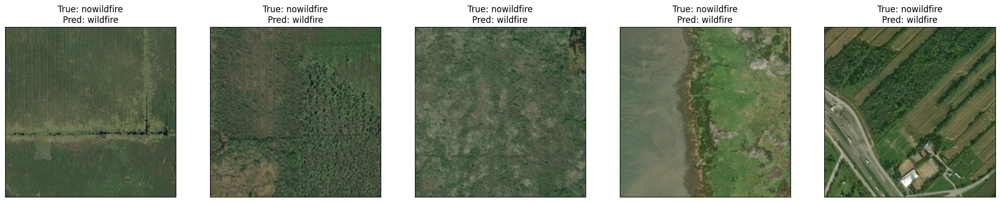

Paths of the misclassified images shown:
/content/wildfire-prediction-dataset/test/nowildfire/-122.947084,49.119961.jpg
/content/wildfire-prediction-dataset/test/nowildfire/-122.957795,49.119955.jpg
/content/wildfire-prediction-dataset/test/nowildfire/-123.012371,49.111431.jpg
/content/wildfire-prediction-dataset/test/nowildfire/-123.199805,49.152146.jpg
/content/wildfire-prediction-dataset/test/nowildfire/-73.413811,45.436142.jpg


In [ ]:
# Display 5 misclassified "nowildfire" images from the test dataset.
show_misclassified_images_by_path(misclassified_paths, misclassified_labels, misclassified_preds, target_label=0, num_images=5)

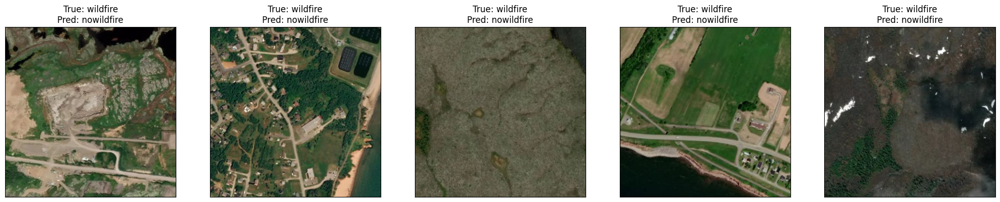

Paths of the misclassified images shown:
/content/wildfire-prediction-dataset/test/wildfire/-60.6867,50.26079.jpg
/content/wildfire-prediction-dataset/test/wildfire/-61.87285,47.36931.jpg
/content/wildfire-prediction-dataset/test/wildfire/-62.62616,51.56745.jpg
/content/wildfire-prediction-dataset/test/wildfire/-65.6656,48.0986.jpg
/content/wildfire-prediction-dataset/test/wildfire/-66.25743,51.3227.jpg


In [ ]:
# Display 5 misclassified "wildfire" images from the test dataset.
show_misclassified_images_by_path(misclassified_paths, misclassified_labels, misclassified_preds, target_label=1, num_images=5)

## XAI Analysis on Selected Missclasified Images: LIME and GradCAM

### True: Nowildfire, Predicted: Wildfire

Image shape: torch.Size([1, 3, 224, 224])


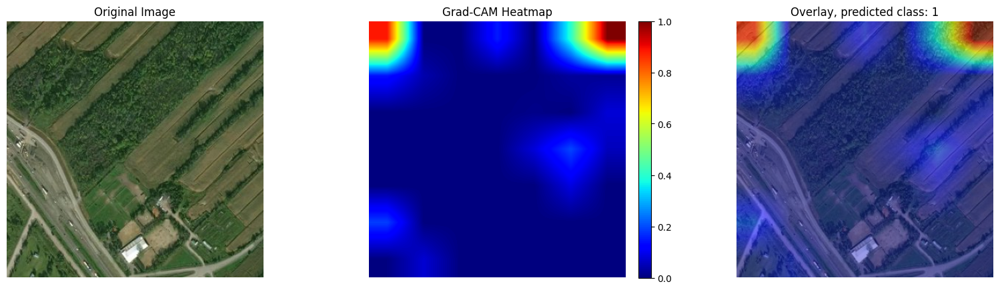

pred calss: 1


In [ ]:
# Perform GradCAM analysis on a misclassified "Nowildfire" image to visualize areas that influenced the model's decision.

# Initialize the GradCAM extractor
cam_extractor = GradCAM(model_loaded, target_layer="layer4")

# Load and preprocess the image to match the input format of ResNet50
test_img_path = "/content/wildfire-prediction-dataset/test/nowildfire/-73.413811,45.436142.jpg"
original_img = plt.imread(test_img_path)
test_image = cv2.imread(test_img_path)
test_image = cv2.resize(test_image, (224, 224))
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
test_image = test_image.astype("float32") / 255.0

# Convert image to a tensor and apply the same transformations used during training
test_image_arr = np.expand_dims(test_image, axis=0)
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

test_image_tensor = transform(test_image).unsqueeze(0).to(device)
print(f"Image shape: {test_image_tensor.shape}")
img = test_image_tensor.to(device)

# Pass the image through the model and extract the GradCAM activation map
output = model_loaded(img)
pred_class = output.argmax(dim=1).item()
activation_map = cam_extractor(pred_class, output)

if isinstance(activation_map, list):
    activation_map = activation_map[0]

# Generate and display the Grad-CAM heatmap, overlaying it onto the original image
activation_map_resized = cv2.resize(activation_map.squeeze(0).cpu().numpy(),
                                    (original_img.shape[1], original_img.shape[0]))

# Normalize and overlay the heatmap onto the original image
activation_map_resized = (activation_map_resized - activation_map_resized.min()) / \
                         (activation_map_resized.max() - activation_map_resized.min())

heatmap = plt.get_cmap("jet")(activation_map_resized)

# Remove the alpha channel (since Matplotlib adds it by default)
heatmap = heatmap[..., :3]

original_img_float = np.float32(original_img) / 255

overlay = heatmap + original_img_float
overlay = overlay / np.max(overlay)

# Display the original image, heatmap, and overlay
fig, ax = plt.subplots(1, 3, figsize=(20, 5))

# Original Image
ax[0].imshow(original_img)
ax[0].axis("off")
ax[0].set_title("Original Image")

# GradCAM Heatmap
heatmap_img = ax[1].imshow(activation_map_resized, cmap="jet")
ax[1].axis("off")
ax[1].set_title("Grad-CAM Heatmap")

# Adding a colorbar (legend) for the heatmap
fig.colorbar(heatmap_img, ax=ax[1], fraction=0.046, pad=0.04)

# Overlay of Heatmap on Image
ax[2].imshow(overlay)
ax[2].axis("off")
ax[2].set_title(f"Overlay, predicted class: {pred_class}")

plt.show()
print(f"pred calss: {pred_class}")

  0%|          | 0/1000 [00:00<?, ?it/s]

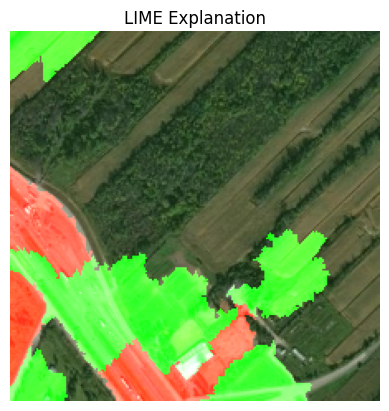

In [ ]:
# Perform LIME analysis on the misclassified "Nowildfire" image to visualize which parts of the image
# contributed to the model's classification decision.

# Define the prediction function for LIME that converts the image into the appropriate tensor format.
def predict_fn(images):
  """
  Convert images to tensors, pass them through the model, and return softmax probabilities.
  Args:
    images (ndarray): Batch of images in NumPy format.
  Returns:
    ndarray: Model's softmax predictions.
  """
  images = torch.tensor(images).permute(0, 3, 1, 2).float().to(device)
  outputs = model_loaded(images)
  return torch.softmax(outputs, dim=1).cpu().detach().numpy()

# Initialize the LIME explainer for image analysis
explainer = lime_image.LimeImageExplainer()

# Explain the model's prediction using LIME for the specified image
explanation = explainer.explain_instance(
    test_image,
    predict_fn,
    top_labels=1,
    hide_color=0,
    num_samples=1000
)

# Get the explanation mask and visualize the areas that contributed to the classification decision
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=False,
    num_features=10,
    hide_rest=False
)

# Display the LIME explanation
plt.imshow(temp)
plt.title("LIME Explanation")
plt.axis('off')
plt.show()

### True: Wildfire, Predicted: Nowildfire
Note: The kernel must be restarted and the model reloaded to perform the GradCAM analysis a second time with meaningful results.

In [ ]:
# Initialize the Grad-CAM extractor for analyzing a misclassified "Wildfire" image.
cam_extractor = GradCAM(model_loaded, target_layer="layer4")

Image shape: torch.Size([1, 3, 224, 224])


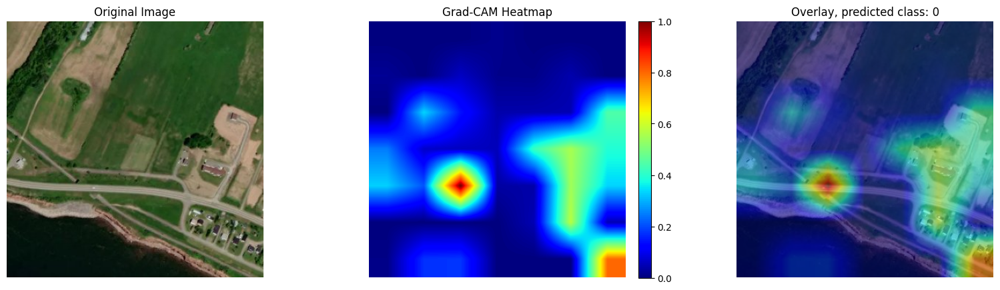

pred calss: 0


In [ ]:
# Perform GradCAM analysis on a misclassified 'Wildfire' image to visualize the areas influencing the model's decision.

# Load and preprocess the image to match the input format of ResNet50
test_img_path = "/content/wildfire-prediction-dataset/test/wildfire/-65.6656,48.0986.jpg"
original_img = plt.imread(test_img_path)
test_image = cv2.imread(test_img_path)
test_image = cv2.resize(test_image, (224, 224))
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
test_image = test_image.astype("float32") / 255.0

# Convert image to a tensor and apply the same transformations used during training
test_image_arr = np.expand_dims(test_image, axis=0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

test_image_tensor = transform(test_image).unsqueeze(0).to(device)
print(f"Image shape: {test_image_tensor.shape}")
img = test_image_tensor.to(device)

# Pass the image through the model and extract the GradCAM activation map
output = model_loaded(img)
pred_class = output.argmax(dim=1).item()
activation_map = cam_extractor(pred_class, output)

if isinstance(activation_map, list):
    activation_map = activation_map[0]

# Generate and display the Grad-CAM heatmap, overlaying it onto the original image
activation_map_resized = cv2.resize(activation_map.squeeze(0).cpu().numpy(),
                                    (original_img.shape[1], original_img.shape[0]))

# Normalize and overlay the heatmap onto the original image
activation_map_resized = (activation_map_resized - activation_map_resized.min()) / \
                         (activation_map_resized.max() - activation_map_resized.min())

heatmap = plt.get_cmap('jet')(activation_map_resized)

# Remove the alpha channel (since Matplotlib adds it by default)
heatmap = heatmap[..., :3]

original_img_float = np.float32(original_img) / 255

overlay = heatmap + original_img_float
overlay = overlay / np.max(overlay)

# Display the original image, heatmap, and overlay
fig, ax = plt.subplots(1, 3, figsize=(20, 5))

# Original Image
ax[0].imshow(original_img)
ax[0].axis("off")
ax[0].set_title("Original Image")

# GradCAM Heatmap
heatmap_img = ax[1].imshow(activation_map_resized, cmap="jet")
ax[1].axis("off")
ax[1].set_title("Grad-CAM Heatmap")

# Adding a colorbar (legend) for the heatmap
fig.colorbar(heatmap_img, ax=ax[1], fraction=0.046, pad=0.04)

# Overlay of Heatmap on Image
ax[2].imshow(overlay)
ax[2].axis("off")
ax[2].set_title(f"Overlay, predicted class: {pred_class}")

plt.show()
print(f"pred calss: {pred_class}")

  0%|          | 0/1000 [00:00<?, ?it/s]

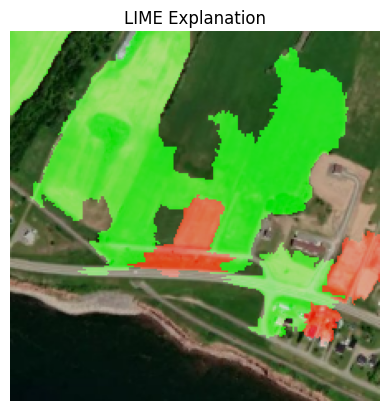

In [ ]:
# Perform LIME analysis on the misclassified "Nowildfire" image to visualize which parts of the image
# contributed to the model's classification decision.


# Define the prediction function for LIME that converts the image into the appropriate tensor format.
# (Since the kernal should be restarted for second GradCAM analysis, same function as above must be defined again)
def predict_fn(images):
  """
  Convert images to tensors, pass them through the model, and return softmax probabilities.
  Args:
    images (ndarray): Batch of images in NumPy format.
  Returns:
    ndarray: Model's softmax predictions.
  """
  images = torch.tensor(images).permute(0, 3, 1, 2).float().to(device)
  outputs = model_loaded(images)
  return torch.softmax(outputs, dim=1).cpu().detach().numpy()

# Initialize the LIME explainer for image analysis
explainer = lime_image.LimeImageExplainer()

# Explain the model's prediction using LIME for the specified image
explanation = explainer.explain_instance(
    test_image,
    predict_fn,
    top_labels=1,
    hide_color=0,
    num_samples=1000
)

# Get the explanation mask and visualize the areas that contributed to the classification decision
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=False,
    num_features=10,
    hide_rest=False
)

# Display the LIME explanation
plt.imshow(temp)
plt.title("LIME Explanation")
plt.axis('off')
plt.show()

# Applying XAI: Testing with Concept Activation Vectors (TCAV)
Note: The following TCAV implementation closely follows the methodology outlined in the official [Captum TCAV tutorial](https://captum.ai/tutorials/TCAV_Image),
with modifications to fit the specific requirements of this project (wildfire dataset and concepts).

Also: After runing the code for the GradCAM evaluations the kernel should be restarted and the model reloded. Moreover, the kernel should be restarted between each TCAV score calculation to ensure correct results.

## Computing TCAV Scores

### Data Loading and Preprocessing

#### Investigate the Data

In [ ]:
# Define the path to the concept dataset, which will be used for TCAV analysis.
concept_dir = "/content/concept-dataset/images_train_test_val/train"

In [ ]:
# Investigate the concept dataset by counting the number of images and their sizes in each concept folder.

# Dictionary to hold the counts of images and their sizes
folder_image_count = {}
image_sizes = {}

# Iterate through each folder (concept) and gather information about the images
for folder_name in os.listdir(concept_dir):
  folder_path = os.path.join(concept_dir, folder_name)
  if os.path.isdir(folder_path):
    folder_image_count[folder_name] = 0
    for image_name in os.listdir(folder_path):
      image_path = os.path.join(folder_path, image_name)
      try:
        with Image.open(image_path) as img:
          img_size = img.size
          folder_image_count[folder_name] += 1
          if img_size not in image_sizes:
              image_sizes[img_size] = 0
          image_sizes[img_size] += 1
      except Exception as e:
        print(f"Error loading image {image_path}: {e}")

In [ ]:
# Print the number of images in each concept folder.
print("Image count per folder:")
for folder, count in folder_image_count.items():
    print(f"{folder}: {count} images")

Image count per folder:
airplane: 350 images
river: 350 images
chaparral: 350 images
baseballdiamond: 350 images
tenniscourt: 350 images
golfcourse: 350 images
parkinglot: 350 images
runway: 350 images
sparseresidential: 350 images
forest: 350 images
freeway: 350 images
denseresidential: 350 images
mobilehomepark: 350 images
overpass: 350 images
mediumresidential: 350 images
harbor: 350 images
buildings: 350 images
agricultural: 350 images
intersection: 350 images
beach: 350 images
storagetanks: 350 images


In [ ]:
# Print the different image sizes found in the concept dataset.
print("\nDifferent image sizes found:")
for size, count in image_sizes.items():
    print(f"Size {size}: {count} images")


Different image sizes found:
Size (256, 256): 7200 images
Size (256, 253): 11 images
Size (253, 256): 21 images
Size (256, 251): 19 images
Size (256, 249): 7 images
Size (250, 256): 7 images
Size (252, 256): 5 images
Size (256, 255): 5 images
Size (247, 256): 4 images
Size (255, 256): 11 images
Size (256, 247): 3 images
Size (254, 256): 11 images
Size (256, 254): 6 images
Size (242, 256): 2 images
Size (247, 247): 30 images
Size (257, 257): 4 images
Size (249, 256): 4 images


#### Create Functions to Load and Preprocess the Data

In [ ]:
# Define a set of transformations to normalize and resize images to 224x224 pixels,
# converting them to tensors as required for the model input.
transforms = transforms.Compose([
  transforms.Resize((224, 224)),
  transforms.ToTensor(),
])

In [ ]:
# Load the concept dataset applying the transformations
concept_dataset = datasets.ImageFolder(root=concept_dir, transform=transforms)

# Create a DataLoader for the concept dataset with a batch size of 32 and no shuffling.
concept_loader = DataLoader(concept_dataset, batch_size=32, shuffle=False, num_workers=4)

In [ ]:
# Define a helper function to load an image from a filename and convert it to a tensor.
def get_tensor_from_filename(filename):
  """
  Loads an image from the specified filename and converts it into a tensor using predefined transformations from the model training.
  Args:
    filename (str): Path to the image file.
  Returns:
    Tensor: The transformed image as a tensor.
  """
  # Load the image using cv2
  img = cv2.imread(filename)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  # Convert to use torchvision.transforms
  img = Image.fromarray(img)

  # Apply the transform function
  return data_transforms(img)

In [ ]:
# Define a helper function to load and transform the class images
def load_image_tensors(class_name, root_path, apply_transform=True):
    path = os.path.join(root_path, class_name)
    filenames = glob.glob(path + '/*.jpg')

    tensors = []
    for filename in filenames:

        # Load the image using cv2
        img = cv2.imread(filename)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Convert to use torchvision.transforms
        img = Image.fromarray(img)

        # Apply the transform and append the tensor
        tensors.append(transform(img) if apply_transform else img)

    return tensors

In [ ]:
# Define a helper function to load and transform images for a specific concept,
# creating a Concept object for TCAV analysis.
def assemble_concept(name, id, concepts_path=concept_dir):
  """
  Loads images for a given concept, applies transformations, and creates a Concept object for TCAV.
  Args:
    name (str): The name of the concept (folder name).
    id (int): The unique ID for the concept.
    concepts_path (str): Path to the folder containing the concept images.
  Returns:
    Concept: A Captum Concept object for use in TCAV.
  """
    concept_path = os.path.join(concepts_path, name) + "/"

    ## Use Captum's CustomIterableDataset and dataset_to_dataloader to load the concept images
    dataset = CustomIterableDataset(get_tensor_from_filename, concept_path)
    concept_iter = dataset_to_dataloader(dataset)

    # Create and return the Concept object
    return Concept(id=id, name=name, data_iter=concept_iter)

#### Prepare the Data
The data for the classes is sampled to work with limited computing power. 500 Random samples are used per class.

Moreover, concepts are split into concepts of interest and remaining concepts. From the remaining concepts, the random folders are constructed. The random forlders encompass images of multiple concepts that are not the construct of interest but of the same domain. These are used to test the significance against

In [ ]:
# Sample 500 images from the "wildfire" and "nowildfire" classes for TCAV analysis to reduce computational load.
# These sampled images are copied to designated target directories for further processing.

# Setup: Define paths to the source directories for wildfire and nowildfire classes
wildfire_src = "/content/wildfire-prediction-dataset/train/wildfire"
nowildfire_src = "/content/wildfire-prediction-dataset/train/nowildfire"

# Create a new directory for the sampled classes
! mkdir /content/sampled_classes
sampled_classes = "/content/sampled_classes"

# Define target paths for the sampled classes
wildfire_dest = os.path.join(sampled_classes, "wildfire")
nowildfire_dest = os.path.join(sampled_classes, "nowildfire")

# Create directories if they don't already exist
os.makedirs(wildfire_dest, exist_ok=True)
os.makedirs(nowildfire_dest, exist_ok=True)

# Specify the number of images to sample
num_images_to_copy = 500

In [ ]:
# Select random wildfire images to copy
wildfire_images = random.sample(os.listdir(wildfire_src), num_images_to_copy)
for img in wildfire_images:
  shutil.copy(os.path.join(wildfire_src, img), wildfire_dest)

# Select random nowildfire images to copy
nowildfire_images = random.sample(os.listdir(nowildfire_src), num_images_to_copy)
for img in nowildfire_images:
  shutil.copy(os.path.join(nowildfire_src, img), nowildfire_dest)

# Print counts to verify the number of copied images
print(f"Copied {len(os.listdir(wildfire_dest))} images to the wildfire folder.")
print(f"Copied {len(os.listdir(nowildfire_dest))} images to the nowildfire folder.")

Copied 500 images to the wildfire folder.
Copied 500 images to the nowildfire folder.


In [ ]:
# Define the subset of concepts of interest out of all concepts

# Define base path for concept images
wildfire_base_path = "/content/sampled_classes/"

# List of all available concept names
concept_names = ["agricultural", "airplane", "baseballdiamond", "beach", "buildings",
                 "chaparral", "denseresidential", "forest", "freeway", "golfcourse",
                 "harbor", "intersection", "mediumresidential", "mobilehomepark",
                 "overpass", "parkinglot", "river", "runway", "sparseresidential",
                 "storagetanks", "tenniscourt"]

# Define subset of concepts of interest
subset_concepts = ["forest", "freeway","denseresidential"]

In [ ]:
# Create random folders with the remaining concepts to test against

# Define the number of random folders to create
num_random_exp = 10
random_folders = [f"random_{i}" for i in range(num_random_exp)]
remaining_concepts = list(set(concept_names) - set(subset_concepts))

# Initialize list to store image paths from remaining concepts
random_pool = []

# Gather image paths from remaining concepts
print("\nCreating a pool of image paths from remaining concepts...")
for concept in remaining_concepts:
    concept_src_path = os.path.join(concept_dir, concept)
    concept_images = os.listdir(concept_src_path)
    random_pool.extend([(concept_src_path, img) for img in concept_images])

# Shuffle the image paths for randomness
random.shuffle(random_pool)

# Print the total number of images in the pool for verification
print(f"Total images available in random pool: {len(random_pool)}")


Creating a pool of image paths from remaining concepts...
Total images available in random pool: 6300


In [ ]:
# Distribute the images of the remaining concepts to the random folders

# Create a directory for random folders
! mkdir /content/random

# Distribute paths to random folders with the naming convention "random500_x" (Original TCAV naming convention)
print("\nDistributing images to random folders...")
images_per_folder = len(random_pool) // num_random_exp

for i in range(num_random_exp):
  # Generate folder names like "random500_0", "random500_1", etc.
  random_folder_name = f"random500_{i}"
  random_folder_path = os.path.join("/content/random", random_folder_name)
  os.makedirs(random_folder_path, exist_ok=True)

  # Get the paths for this folder
  folder_images = random_pool[i * images_per_folder:(i + 1) * images_per_folder]

  # Copy the images from their source paths to the random folder
  for src_path, img in folder_images:
    shutil.copy(os.path.join(src_path, img), random_folder_path)

  # Print the number of images in the folder for verification
  print(f"Assigned {len(os.listdir(random_folder_path))} images to folder: {random_folder_name}")


Distributing images to random folders...
Assigned 630 images to folder: random500_0
Assigned 630 images to folder: random500_1
Assigned 630 images to folder: random500_2
Assigned 630 images to folder: random500_3
Assigned 630 images to folder: random500_4
Assigned 630 images to folder: random500_5
Assigned 630 images to folder: random500_6
Assigned 630 images to folder: random500_7
Assigned 630 images to folder: random500_8
Assigned 630 images to folder: random500_9


#### Assemble the Concepts to Test

In [ ]:
# Assemble concepts of interest
forest_concept = assemble_concept("forest", 0, concepts_path=concept_dir)
denseresidential_concept = assemble_concept("denseresidential", 1, concepts_path=concept_dir)
freeway_concept = assemble_concept("freeway", 2, concepts_path=concept_dir)

# Assemble the random concepts
random_0_concept = assemble_concept("random500_0", 3, concepts_path="/content/random")
random_1_concept = assemble_concept("random500_1", 4, concepts_path="/content/random")
random_2_concept = assemble_concept("random500_2", 5, concepts_path="/content/random")
random_3_concept = assemble_concept("random500_3", 6, concepts_path="/content/random")
random_4_concept = assemble_concept("random500_4", 7, concepts_path="/content/random")
random_5_concept = assemble_concept("random500_5", 8, concepts_path="/content/random")
random_6_concept = assemble_concept("random500_6", 9, concepts_path="/content/random")
random_7_concept = assemble_concept("random500_7", 10, concepts_path="/content/random")
random_8_concept = assemble_concept("random500_8", 11, concepts_path="/content/random")
random_9_concept = assemble_concept("random500_9", 12, concepts_path="/content/random")

#### Visualize Concepts of Interest and Random Concepts

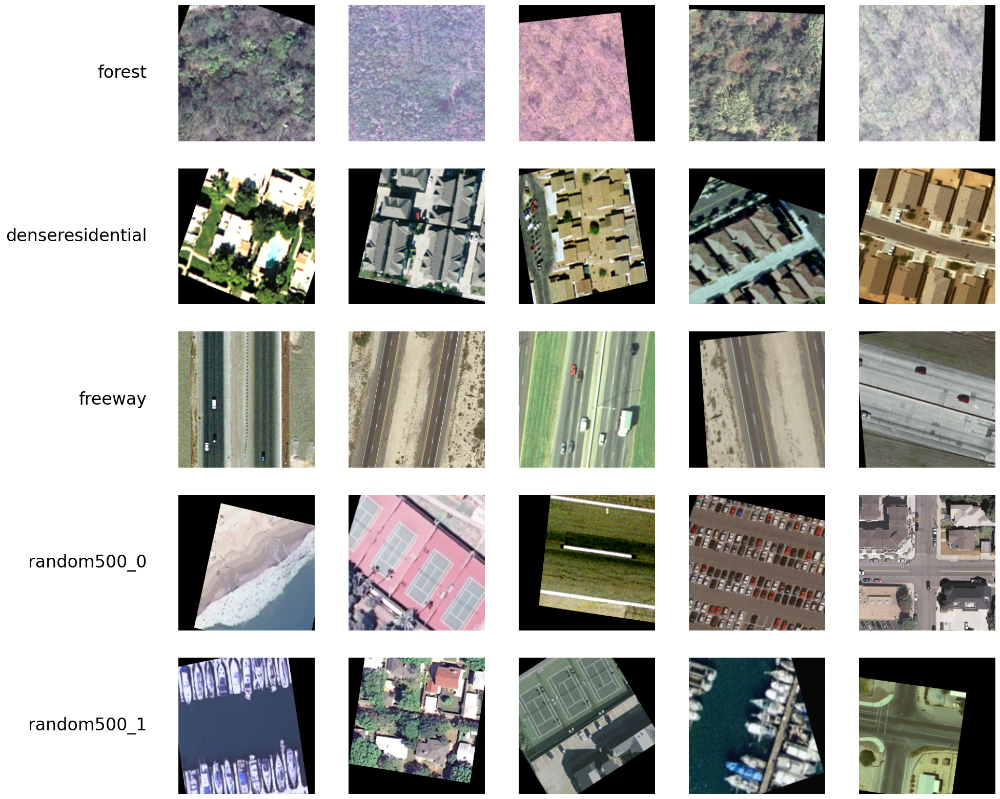

In [ ]:
# Define plot to show example images of the concepts
n_figs = 5
n_concepts = 5

# List of concepts to be visualized
concepts = [forest_concept, denseresidential_concept, freeway_concept, random_0_concept, random_1_concept]

# Create a grid of subplots for visualization
fig, axs = plt.subplots(n_concepts, n_figs + 1, figsize=(25, 4 * n_concepts))

# Loop through each concept and corresponding subplot
for c, concept in enumerate(concepts):
  # Determine the path based on concept type
  if "random" in concept.name:
    concept_path = os.path.join("/content/random", concept.name) + "/"
  else:
    concept_path = os.path.join(concept_dir, concept.name) + "/"

  img_files = glob.glob(concept_path + '*')

  # Display images in the subplots
  for i, img_file in enumerate(img_files[:n_figs + 1]):
    if os.path.isfile(img_file):
        if i == 0:
            axs[c, i].text(1.0, 0.5, str(concept.name), ha="right", va="center", family="sans-serif", size=24)
        else:
          img = plt.imread(img_file)
          axs[c, i].imshow(img)

        axs[c, i].axis("off")

plt.show()

#### Parameter Setup

In [ ]:
# Print the model structure to identify layer names
print(model_loaded)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
# Load dataset and map class names to indices
dataset = datasets.ImageFolder(root=train_dir)
class_to_idx = dataset.class_to_idx
print(class_to_idx)

{'nowildfire': 0, 'wildfire': 1}


In [ ]:
# Define indices for wildfire and nowildfire classes
wildfire_ind = 1
nowildfire_ind = 0

#### Class Data Loading and Preprocessing

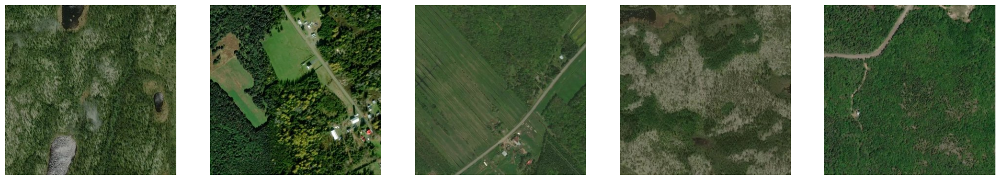

In [ ]:
# Load wildfire images and visualize a subset to ensure correct loading
wildfire_imgs = load_image_tensors("wildfire", root_path="/content/sampled_classes", apply_transform=False)

# Create a subplot for visualizing wildfire images
fig, axs = plt.subplots(1, 5, figsize = (25, 5))
axs[0].imshow(wildfire_imgs[40])
axs[1].imshow(wildfire_imgs[41])
axs[2].imshow(wildfire_imgs[34])
axs[3].imshow(wildfire_imgs[31])
axs[4].imshow(wildfire_imgs[30])

axs[0].axis('off')
axs[1].axis('off')
axs[2].axis('off')
axs[3].axis('off')
axs[4].axis('off')

plt.show()

In [ ]:
# Convert wildfire images to tensors using specified transformations
wildfire_tensors = torch.stack([data_transforms(img) for img in wildfire_imgs])

### TCAV Score Calculation
Note: Since the recommended 500 runs are outside the scope of the available computing power, the scores are calculated three times over 8 runs each to assess reliability. The kernel must be restarted between each calculation.

In [ ]:
# Define the set of concepts for TCAV score calculation
experimental_set_concepts = [[forest_concept, denseresidential_concept, freeway_concept]]

In [ ]:
# First TCAV score calculation
# Define layers for extracting Concept Activation Vectors (CAVs)
layer = ["layer1", "layer2", "layer3", "layer4"]

# Initialize TCAV with specified layers
mytcav_concepts = TCAV(model=model_loaded,
              layers=layer,
              layer_attr_method=LayerIntegratedGradients(model_loaded, None, multiply_by_inputs=False))

/usr/local/lib/python3.10/dist-packages/captum/concept/_utils/classifier.py:130: UserWarning: Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class
  warnings.warn(


In [ ]:
# Calculate TCAV scores for the defined concepts
tcav_scores_concepts = mytcav_concepts.interpret(inputs=wildfire_tensors,
                                        experimental_sets=experimental_set_concepts,
                                        target=wildfire_ind,
                                        n_steps=8,
                                       )
# Print the computed TCAV scores
print(tcav_scores_concepts)

/usr/local/lib/python3.10/dist-packages/captum/_utils/av.py:80: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  av = torch.load(fl)
/usr/local/lib/python3.10/dist-packages/cap

defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x7af945d66710>, {'0-1-2': defaultdict(None, {'layer1': {'sign_count': tensor([0.2260, 0.7140, 0.8320]), 'magnitude': tensor([-0.1441,  0.0986,  0.0708])}, 'layer2': {'sign_count': tensor([0.0020, 0.9740, 0.9020]), 'magnitude': tensor([-0.2640,  0.1754,  0.0796])}, 'layer3': {'sign_count': tensor([0.4660, 0.4280, 0.0820]), 'magnitude': tensor([ 0.0004, -0.0038, -0.0387])}, 'layer4': {'sign_count': tensor([1., 0., 1.]), 'magnitude': tensor([ 0.1375, -0.1222,  0.0208])}})})


In [ ]:
# Auxiliary functions for visualizing TCAV scores
def format_float(f):
  """
  Format a float for readability, using scientific notation if needed.
  Args:
    f (float): The float to format.
  Returns:
    float: Formatted float.
  """
  return float("{:.3f}".format(f) if abs(f) >= 0.0005 else "{:.3e}".format(f))

def plot_tcav_scores(experimental_sets, tcav_scores, layers):
  """
  Plot TCAV scores for different experimental sets and layers.
  Args:
    experimental_sets (list): List of assembled experimental concept sets.
    tcav_scores (dict): Dictionary of TCAV scores.
    layers (list): List of analysed layers.
    """
  fig, ax = plt.subplots(1, len(experimental_sets), figsize=(20, 5))

  barWidth = 1 / (len(experimental_sets[0]) + 1)

  for idx_es, concepts in enumerate(experimental_sets):
    concepts_key = concepts_to_str(concepts)
    pos = [np.arange(len(layers))]
    for i in range(1, len(concepts)):
      pos.append([(x + barWidth) for x in pos[i-1]])

    _ax = (ax[idx_es] if len(experimental_sets) > 1 else ax)
    for i in range(len(concepts)):
      val = [format_float(scores['sign_count'][i]) for layer, scores in tcav_scores[concepts_key].items()]
      # Print the shape and type of `val` for debugging
      print(f"Concept: {concepts[i].name}")
      print(f"Values: {val}")
      print(f"Type of val: {type(val)}")
      print(f"Length of val: {len(val)}\n")

      _ax.bar(pos[i], val, width=barWidth, edgecolor='white', label=concepts[i].name)

    _ax.set_xlabel('Set {}'.format(str(idx_es)), fontweight='bold', fontsize=8)
    _ax.set_xticks([r + 0.3 * barWidth for r in range(len(layers))])
    _ax.set_xticklabels(layers, fontsize=8)

    _ax.legend(fontsize=8)

  plt.show()

Concept: forest
Values: [0.226, 0.002, 0.466, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: denseresidential
Values: [0.714, 0.974, 0.428, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: freeway
Values: [0.832, 0.902, 0.082, 1.0]
Type of val: <class 'list'>
Length of val: 4



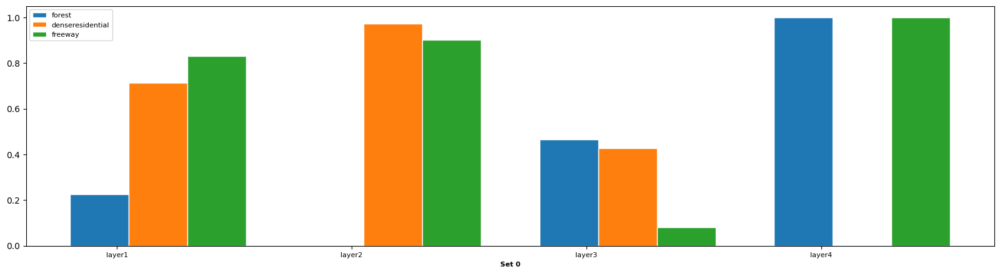

In [ ]:
# Plot TCAV scores for the first calculation of the experimental set concepts
plot_tcav_scores(experimental_set_concepts, tcav_scores_concepts, layer)

In [ ]:
# Second TCAV score calculation
# Define layers for extracting Concept Activation Vectors (CAVs)
layer = ["layer1", "layer2", "layer3", "layer4"]

# Initialize TCAV with specified layers
mytcav_concepts2 = TCAV(model=model_loaded,
              layers=layer,
              layer_attr_method=LayerIntegratedGradients(model_loaded, None, multiply_by_inputs=False))

/usr/local/lib/python3.10/dist-packages/captum/concept/_utils/classifier.py:130: UserWarning: Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class
  warnings.warn(


In [ ]:
# Calculate TCAV scores a second time for the defined concepts
tcav_scores_concepts2 = mytcav_concepts2.interpret(inputs=wildfire_tensors,
                                        experimental_sets=experimental_set_concepts,
                                        target=wildfire_ind,
                                        n_steps=8,
                                       )
# Print the computed TCAV scores
print(tcav_scores_concepts2)

/usr/local/lib/python3.10/dist-packages/captum/concept/_core/cav.py:165: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  save_dict = torch.load(cavs_path)


defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x7a8c5c62eb90>, {'0-1-2': defaultdict(None, {'layer1': {'sign_count': tensor([0.2680, 0.5480, 0.9060]), 'magnitude': tensor([-0.1075,  0.0185,  0.1271])}, 'layer2': {'sign_count': tensor([0.0100, 0.9380, 0.8600]), 'magnitude': tensor([-0.2209,  0.1312,  0.0687])}, 'layer3': {'sign_count': tensor([0.9440, 0.3480, 0.2120]), 'magnitude': tensor([ 0.0460, -0.0103, -0.0266])}, 'layer4': {'sign_count': tensor([1., 0., 1.]), 'magnitude': tensor([ 0.1053, -0.1251,  0.0389])}})})


Concept: forest
Values: [0.268, 0.01, 0.944, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: denseresidential
Values: [0.548, 0.938, 0.348, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: freeway
Values: [0.906, 0.86, 0.212, 1.0]
Type of val: <class 'list'>
Length of val: 4



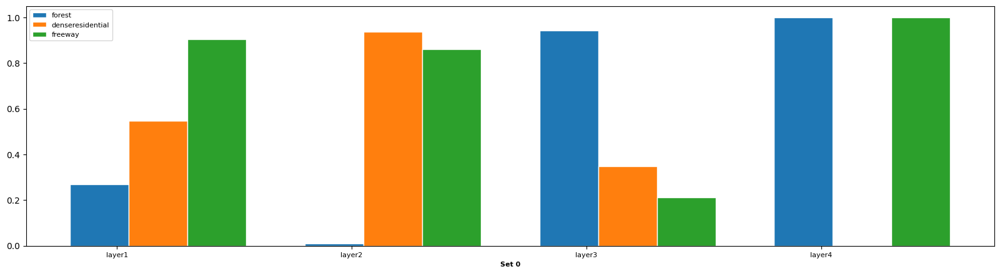

In [ ]:
# Plot TCAV scores for the second calculation of the experimental set concepts
plot_tcav_scores(experimental_set_concepts, tcav_scores_concepts2, layer)

In [ ]:
# Third TCAV score calculation
# Define layers for extracting Concept Activation Vectors (CAVs)
layer = ["layer1", "layer2", "layer3", "layer4"]

# Initialize TCAV with specified layers
mytcav_concepts3 = TCAV(model=model_loaded,
              layers=layer,
              layer_attr_method=LayerIntegratedGradients(model_loaded, None, multiply_by_inputs=False))

/usr/local/lib/python3.10/dist-packages/captum/concept/_utils/classifier.py:130: UserWarning: Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class
  warnings.warn(


In [ ]:
# Calculate TCAV scores a third time for the defined concepts
tcav_scores_concepts3 = mytcav_concepts3.interpret(inputs=wildfire_tensors,
                                        experimental_sets=experimental_set_concepts,
                                        target=wildfire_ind,
                                        n_steps=8,
                                       )
# Print the computed TCAV scores
print(tcav_scores_concepts3)

/usr/local/lib/python3.10/dist-packages/captum/_utils/av.py:80: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  av = torch.load(fl)
/usr/local/lib/python3.10/dist-packages/cap

defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x7d946543ff40>, {'0-1-2': defaultdict(None, {'layer1': {'sign_count': tensor([0.3900, 0.6820, 0.7300]), 'magnitude': tensor([-0.0617,  0.0597,  0.0556])}, 'layer2': {'sign_count': tensor([0.0040, 0.9820, 0.6080]), 'magnitude': tensor([-0.1745,  0.2637,  0.0125])}, 'layer3': {'sign_count': tensor([0.6780, 0.1880, 0.5720]), 'magnitude': tensor([ 0.0142, -0.0221,  0.0023])}, 'layer4': {'sign_count': tensor([1., 0., 0.]), 'magnitude': tensor([ 0.1627, -0.0582, -0.0074])}})})


Concept: forest
Values: [0.39, 0.004, 0.678, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: denseresidential
Values: [0.682, 0.982, 0.188, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: freeway
Values: [0.73, 0.608, 0.572, 0.0]
Type of val: <class 'list'>
Length of val: 4



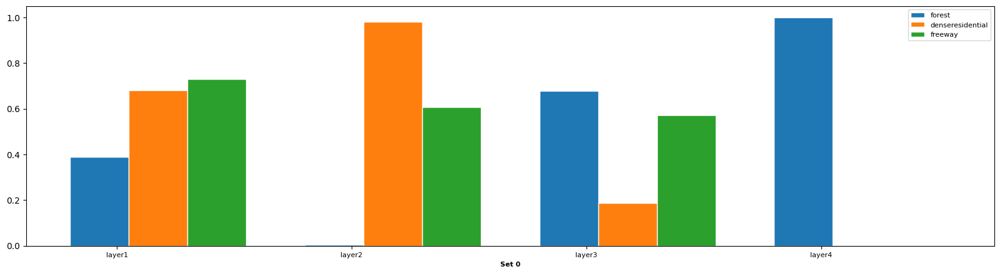

In [ ]:
# Plot TCAV scores for the third calculation of the experimental set concepts
plot_tcav_scores(experimental_set_concepts, tcav_scores_concepts3, layer)

# TCAV Score Evaluation

## Significante Tests

### Helper Functions for Two-Sided T-Test

In [ ]:
def assemble_scores(tcav_scores, experimental_sets, idx, score_layer, score_type):
  """
  Assembles a list of TCAV scores for specified layers and types from experimental sets.
  Args:
    tcav_scores (dict): Dictionary containing TCAV scores.
    experimental_sets (list): List of experimental concept sets.
    idx (int): Index of the score to retrieve (from set).
    score_layer (str): Layer name to fetch scores from.
    score_type (str): Type of score to retrieve ('sign_count' or 'magnitude').
  Returns:
    list: List of TCAV scores for the specified layer and type.
    """
    score_list = []
    for concepts in experimental_sets:
        score_list.append(tcav_scores["-".join([str(c.id) for c in concepts])][score_layer][score_type][idx])

    return score_list

In [ ]:
def get_pval(tcav_scores, experimental_set, score_layer, score_type, alpha=0.05, print_ret=False):
  """
  Calculates p-values to test the significance of TCAV scores between two sets using a two sided t-test.
  Compares significance of concept of interest (P1) and random concepts (P2).
  Args:
    tcav_scores (dict): Dictionary containing TCAV scores.
    experimental_set (list): List of experimental concept sets.
    score_layer (str): Layer name to fetch scores from.
    score_type (str): Type of score to retrieve ('sign_count' or 'magnitude').
    alpha (float, optional): Significance level for the test (default is 0.05).
    print_ret (bool, optional): Whether to print results (default is False).
    Returns:
        tuple: P1, P2 lists of TCAV scores, formatted p-value, and relation ("Disjoint" or "Overlap").
    """
    # Retrieve TCAV scores for both concepts of the set
    P1 = assemble_scores(tcav_scores, experimental_set, 0, score_layer, score_type)
    P2 = assemble_scores(tcav_scores, experimental_set, 1, score_layer, score_type)

    if print_ret:
        print('P1[mean, std]: ', format_float(np.mean(P1)), format_float(np.std(P1)))
        print('P2[mean, std]: ', format_float(np.mean(P2)), format_float(np.std(P2)))

    # Perform t-test to calculate p-value
    _, pval = ttest_ind(P1, P2)

    if print_ret:
        print("p-values:", format_float(pval))

    # Determine relationship (significance) based on p-value
    if pval < alpha:
        relation = "Disjoint"
        if print_ret:
            print("Disjoint")
    else:
        relation = "Overlap"
        if print_ret:
            print("Overlap")
    #print(f"P1:{P1}")
    #print(f"P2:{P2}")
    return P1, P2, format_float(pval), relation

In [ ]:
# n is set to three because each concept (forest, random) is tested three times within the experimental set.
# Used to determine which TCAV scores to base the t-test calculations off of for the respective concept.
n = 3

def show_boxplots(tcav_scores, experimental_set, layer, metric='sign_count'):
  """
  Create boxplots to visualize TCAV scores for two concepts and compare them.
  Args:
    tcav_scores (dict): Dictionary containing TCAV scores.
    experimental_set (list): List of experimental concept sets.
    layer (str): Layer name to fetch scores from.
    metric (str, optional): Metric to use ('sign_count' or 'magnitude', default is 'sign_count').
    Returns:
        None: Displays boxplots of TCAV scores.
    """

  def format_label_text(experimental_set):
    """
    Generate labels for the boxplots from the experimental set.
    Args:
      experimental_set (list): List of experimental concepts sets.
    Returns:
        list: Formatted labels for the boxplots.
    """
    concept_id_list = [exp.name if i == 0 else \
                          exp.name.split('_')[0] for i, exp in enumerate(experimental_set[0])]
    return concept_id_list

  n_plots = 2

  fig, ax = plt.subplots(1, n_plots, figsize = (25, 7 * 1))
  fs = 18
  for i in range(n_plots):
    esl = experimental_set[i * n : (i+1) * n]
    print(f"esl: {esl}")
    P1, P2, pval, relation = get_pval(tcav_scores, esl, layer, metric)

    ax[i].set_ylim([0, 1])
    ax[i].set_title(layer + "-" + metric + " (pval=" + str(pval) + " - " + relation + ")", fontsize=fs)
    ax[i].boxplot([P1, P2], showfliers=True)

    ax[i].set_xticklabels(format_label_text(esl), fontsize=fs)

  plt.show()

### Forest Concept

#### Calculation of TCAV Scores

In [ ]:
# Define experimental set pairing target concepts with random concepts to test significance

experimental_set_forest = [
    [forest_concept, random_0_concept],
    [forest_concept, random_1_concept],
    [forest_concept, random_2_concept],
    [random_0_concept, random_1_concept],
    [random_0_concept, random_2_concept],
    [random_0_concept, random_3_concept]
    ]

In [ ]:
# TCAV score calculation to test the significance of the forest concept
# Define layers for extracting Concept Activation Vectors (CAVs)
layer = ["layer1", "layer2", "layer3", "layer4"]

# Initialize TCAV with specified layers
mytcav_forest = TCAV(model=model_loaded,
              layers=layer,
              layer_attr_method=LayerIntegratedGradients(model_loaded, None, multiply_by_inputs=False))

/usr/local/lib/python3.10/dist-packages/captum/concept/_utils/classifier.py:130: UserWarning: Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class
  warnings.warn(


In [ ]:
# Calculate TCAV scores for the forest concept
tcav_scores_forest = mytcav_forest.interpret(inputs=wildfire_tensors,
                                        experimental_sets=experimental_set_forest,
                                        target=wildfire_ind,
                                        n_steps=8,
                                       )
# Print the computed TCAV scores
print(tcav_scores_forest)

/usr/local/lib/python3.10/dist-packages/captum/_utils/av.py:80: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  av = torch.load(fl)
/usr/local/lib/python3.10/dist-packages/cap

defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x7af945fd3520>, {'0-3': defaultdict(None, {'layer1': {'sign_count': tensor([0.8100, 0.1900]), 'magnitude': tensor([ 0.1538, -0.1538])}, 'layer2': {'sign_count': tensor([0.0360, 0.9640]), 'magnitude': tensor([-0.1144,  0.1144])}, 'layer3': {'sign_count': tensor([0.4060, 0.5940]), 'magnitude': tensor([-0.0047,  0.0047])}, 'layer4': {'sign_count': tensor([1., 0.]), 'magnitude': tensor([ 0.0405, -0.0405])}}), '0-4': defaultdict(None, {'layer1': {'sign_count': tensor([0.5400, 0.4600]), 'magnitude': tensor([ 0.0100, -0.0100])}, 'layer2': {'sign_count': tensor([0.0200, 0.9800]), 'magnitude': tensor([-0.1221,  0.1221])}, 'layer3': {'sign_count': tensor([0.7920, 0.2080]), 'magnitude': tensor([ 0.0235, -0.0235])}, 'layer4': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0164,  0.0164])}}), '0-5': defaultdict(None, {'layer1': {'sign_count': tensor([0.4620, 0.5380]), 'magnitude': tensor([-0.0105,  0.0105])}, 'layer2': {'sign_coun

Concept: forest
Values: [0.81, 0.036, 0.406, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.19, 0.964, 0.594, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: forest
Values: [0.54, 0.02, 0.792, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [0.46, 0.98, 0.208, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: forest
Values: [0.462, 0.002, 0.818, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_2
Values: [0.538, 0.998, 0.182, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.374, 0.83, 0.836, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [0.626, 0.17, 0.164, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.344, 0.47, 0.244, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_2
Values: [0.656, 0.53, 0.756, 1.0]
Type of val: <class 'list'>
Length of val: 4

Conce

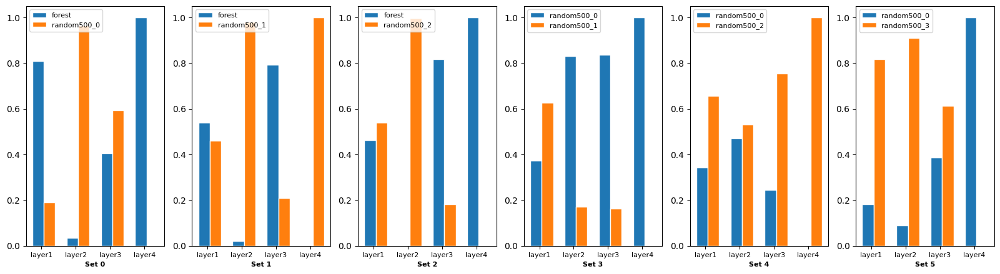

In [ ]:
# Plot TCAV scores for the forest concept
plot_tcav_scores(experimental_set_forest, tcav_scores_forest, layer)

In [ ]:
# Investigate and print detailed TCAV scores for each of the three forst-random sets and layers
for concept_pair, layers_dict in tcav_scores_forest.items():
  print(f"Concept Pair: {concept_pair}")
  for layer, scores in layers_dict.items():
    print(f"  Layer: {layer}")
    print(f"    Sign Count: {scores['sign_count']}")
    print(f"    Magnitude: {scores['magnitude']}")

Concept Pair: 0-3
  Layer: layer1
    Sign Count: tensor([0.8100, 0.1900])
    Magnitude: tensor([ 0.1538, -0.1538])
  Layer: layer2
    Sign Count: tensor([0.0360, 0.9640])
    Magnitude: tensor([-0.1144,  0.1144])
  Layer: layer3
    Sign Count: tensor([0.4060, 0.5940])
    Magnitude: tensor([-0.0047,  0.0047])
  Layer: layer4
    Sign Count: tensor([1., 0.])
    Magnitude: tensor([ 0.0405, -0.0405])
Concept Pair: 0-4
  Layer: layer1
    Sign Count: tensor([0.5400, 0.4600])
    Magnitude: tensor([ 0.0100, -0.0100])
  Layer: layer2
    Sign Count: tensor([0.0200, 0.9800])
    Magnitude: tensor([-0.1221,  0.1221])
  Layer: layer3
    Sign Count: tensor([0.7920, 0.2080])
    Magnitude: tensor([ 0.0235, -0.0235])
  Layer: layer4
    Sign Count: tensor([0., 1.])
    Magnitude: tensor([-0.0164,  0.0164])
Concept Pair: 0-5
  Layer: layer1
    Sign Count: tensor([0.4620, 0.5380])
    Magnitude: tensor([-0.0105,  0.0105])
  Layer: layer2
    Sign Count: tensor([0.0020, 0.9980])
    Magnitude:

#### Significance Tests: Boxplots

esl: [[Concept(0, 'forest'), Concept(3, 'random500_0')], [Concept(0, 'forest'), Concept(4, 'random500_1')], [Concept(0, 'forest'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


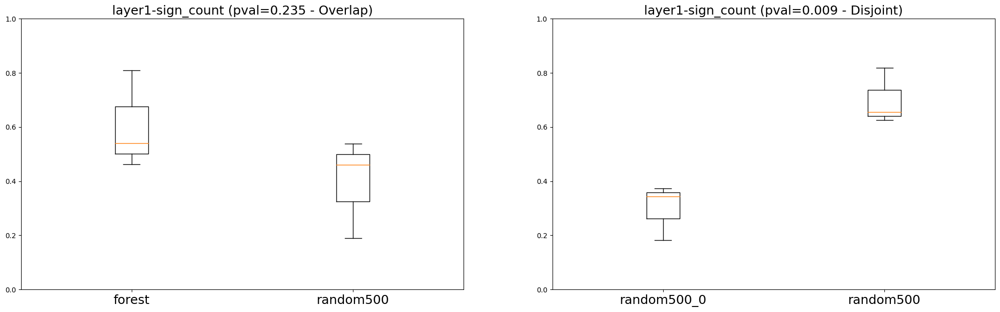

In [ ]:
# Display boxplots comparing TCAV scores for forest concept and the random concepts for "layer1"
show_boxplots (tcav_scores_forest, experimental_set_forest, "layer1")

esl: [[Concept(0, 'forest'), Concept(3, 'random500_0')], [Concept(0, 'forest'), Concept(4, 'random500_1')], [Concept(0, 'forest'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


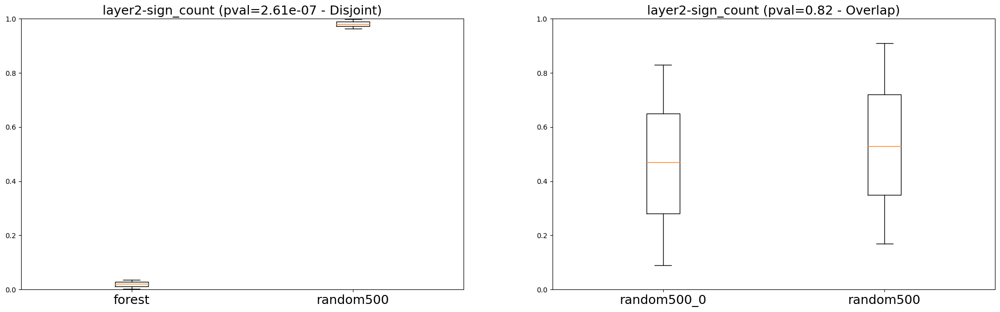

In [ ]:
# Display boxplots comparing TCAV scores for forest concept and the random concepts for "layer2"
show_boxplots (tcav_scores_forest, experimental_set_forest, "layer2")

esl: [[Concept(0, 'forest'), Concept(3, 'random500_0')], [Concept(0, 'forest'), Concept(4, 'random500_1')], [Concept(0, 'forest'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


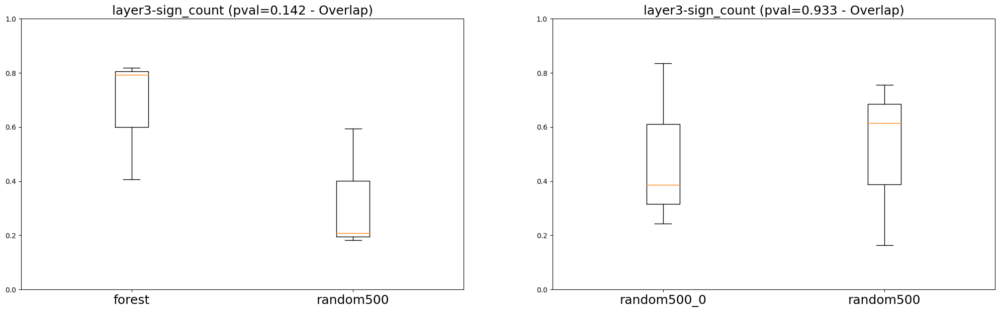

In [ ]:
# Display boxplots comparing TCAV scores for forest concept and the random concepts for "layer3"
show_boxplots (tcav_scores_forest, experimental_set_forest, "layer3")

esl: [[Concept(0, 'forest'), Concept(3, 'random500_0')], [Concept(0, 'forest'), Concept(4, 'random500_1')], [Concept(0, 'forest'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


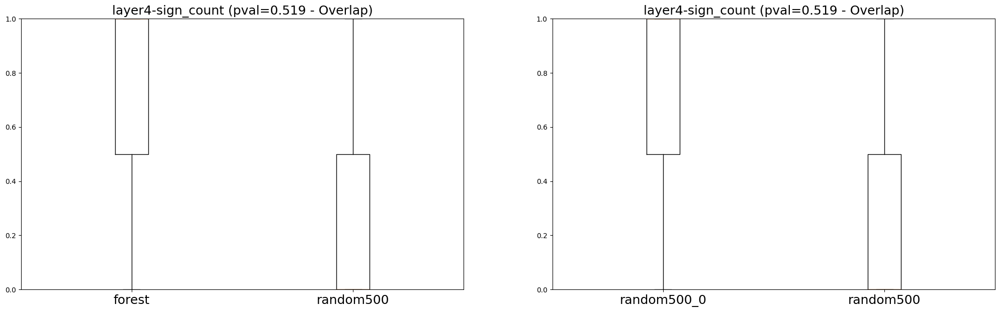

In [ ]:
# Display boxplots comparing TCAV scores for forest concept and the random concepts for "layer4"
show_boxplots (tcav_scores_forest, experimental_set_forest, "layer4")

### Denseresidential Concept

#### Calculation of TCAV Scores

In [ ]:
# Define experimental set pairing target concepts with random concepts to test significance

experimental_set_denseresidential = [
    [denseresidential_concept, random_0_concept],
    [denseresidential_concept, random_1_concept],
    [denseresidential_concept, random_2_concept],
    [random_0_concept, random_1_concept],
    [random_0_concept, random_2_concept],
    [random_0_concept, random_3_concept]
    ]

In [ ]:
# TCAV score calculation to test the significance of the denseresidential concept
# Define layers for extracting Concept Activation Vectors (CAVs)
layer = ["layer1", "layer2", "layer3", "layer4"]

# Initialize TCAV with specified layers
mytcav_denseresidential = TCAV(model=model_loaded,
              layers=layer,
              layer_attr_method=LayerIntegratedGradients(model_loaded, None, multiply_by_inputs=False))

/usr/local/lib/python3.10/dist-packages/captum/concept/_utils/classifier.py:130: UserWarning: Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class
  warnings.warn(


In [ ]:
# Calculate TCAV scores for the denseresidential concept
tcav_scores_denseresidential = mytcav_denseresidential.interpret(inputs=wildfire_tensors,
                                        experimental_sets=experimental_set_denseresidential,
                                        target=wildfire_ind,
                                        n_steps=8,
                                       )
# Print the computed TCAV scores
print(tcav_scores_denseresidential)

/usr/local/lib/python3.10/dist-packages/captum/concept/_core/cav.py:165: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  save_dict = torch.load(cavs_path)
/usr/local/lib/pytho

defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x7af945cf1120>, {'1-3': defaultdict(None, {'layer1': {'sign_count': tensor([0.9720, 0.0280]), 'magnitude': tensor([ 0.2392, -0.2392])}, 'layer2': {'sign_count': tensor([0.9900, 0.0100]), 'magnitude': tensor([ 0.1407, -0.1407])}, 'layer3': {'sign_count': tensor([0.2340, 0.7660]), 'magnitude': tensor([-0.0239,  0.0239])}, 'layer4': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.1291,  0.1291])}}), '1-4': defaultdict(None, {'layer1': {'sign_count': tensor([0.9220, 0.0780]), 'magnitude': tensor([ 0.1883, -0.1883])}, 'layer2': {'sign_count': tensor([0.9900, 0.0100]), 'magnitude': tensor([ 0.2250, -0.2250])}, 'layer3': {'sign_count': tensor([0.1260, 0.8740]), 'magnitude': tensor([-0.0339,  0.0339])}, 'layer4': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0727,  0.0727])}}), '1-5': defaultdict(None, {'layer1': {'sign_count': tensor([0.8540, 0.1460]), 'magnitude': tensor([ 0.1233, -0.1233])}, 'layer2': {'sign_coun

Concept: denseresidential
Values: [0.972, 0.99, 0.234, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.028, 0.01, 0.766, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: denseresidential
Values: [0.922, 0.99, 0.126, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [0.078, 0.01, 0.874, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: denseresidential
Values: [0.854, 0.984, 0.256, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_2
Values: [0.146, 0.016, 0.744, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.374, 0.83, 0.836, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [0.626, 0.17, 0.164, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.344, 0.47, 0.244, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_2
Values: [0.656, 0.53, 0.756, 1.0]
Type of val: <class

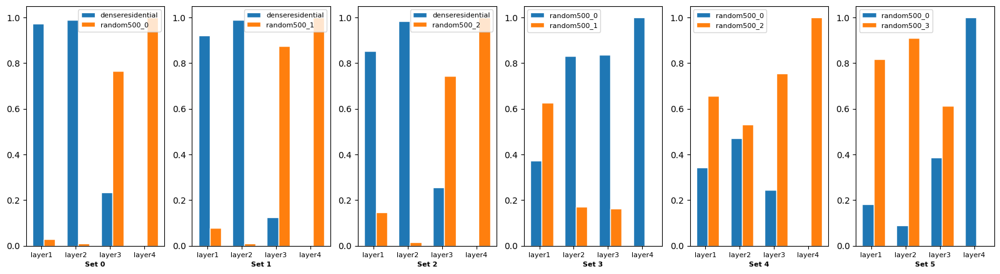

In [ ]:
# Plot TCAV scores for the denseresidential concept
plot_tcav_scores(experimental_set_denseresidential, tcav_scores_denseresidential, layer)

#### Significance Tests: Boxplots

esl: [[Concept(1, 'denseresidential'), Concept(3, 'random500_0')], [Concept(1, 'denseresidential'), Concept(4, 'random500_1')], [Concept(1, 'denseresidential'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


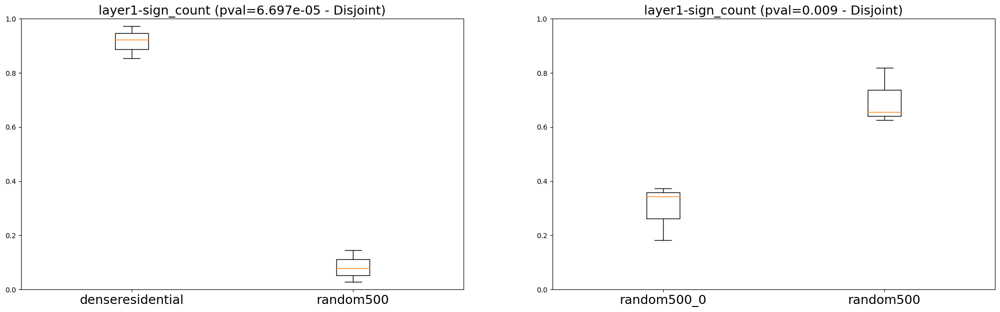

In [ ]:
# Display boxplots comparing TCAV scores for denseresidential concept and the random concepts for "layer1"
show_boxplots (tcav_scores_denseresidential, experimental_set_denseresidential, "layer1")

esl: [[Concept(1, 'denseresidential'), Concept(3, 'random500_0')], [Concept(1, 'denseresidential'), Concept(4, 'random500_1')], [Concept(1, 'denseresidential'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


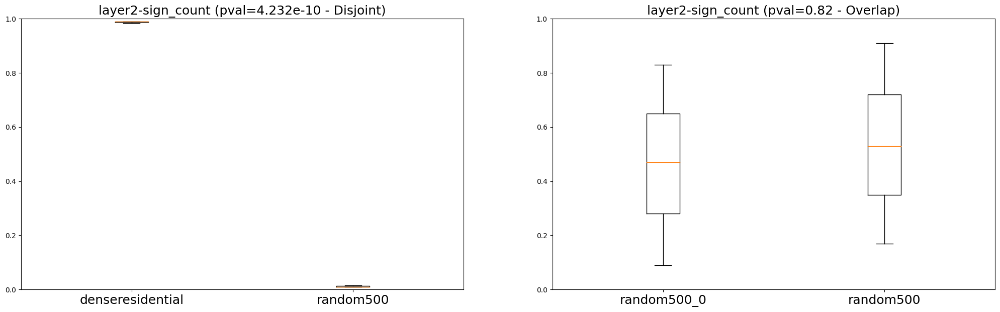

In [ ]:
# Display boxplots comparing TCAV scores for denseresidential concept and the random concepts for "layer2"
show_boxplots (tcav_scores_denseresidential, experimental_set_denseresidential, "layer2")

esl: [[Concept(1, 'denseresidential'), Concept(3, 'random500_0')], [Concept(1, 'denseresidential'), Concept(4, 'random500_1')], [Concept(1, 'denseresidential'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


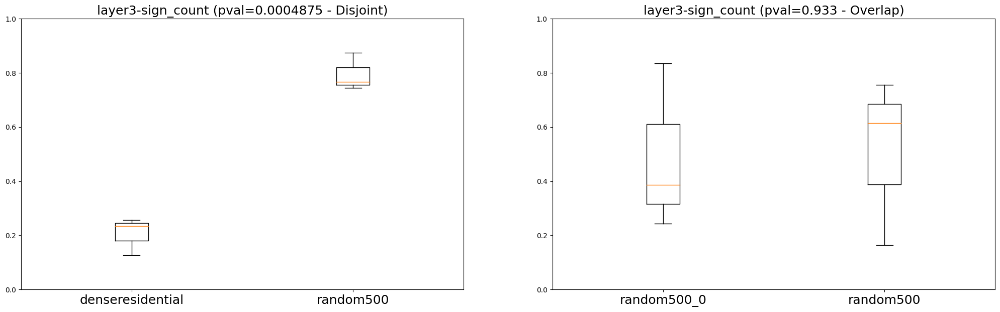

In [ ]:
# Display boxplots comparing TCAV scores for denseresidential concept and the random concepts for "layer3"
show_boxplots (tcav_scores_denseresidential, experimental_set_denseresidential, "layer3")

esl: [[Concept(1, 'denseresidential'), Concept(3, 'random500_0')], [Concept(1, 'denseresidential'), Concept(4, 'random500_1')], [Concept(1, 'denseresidential'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


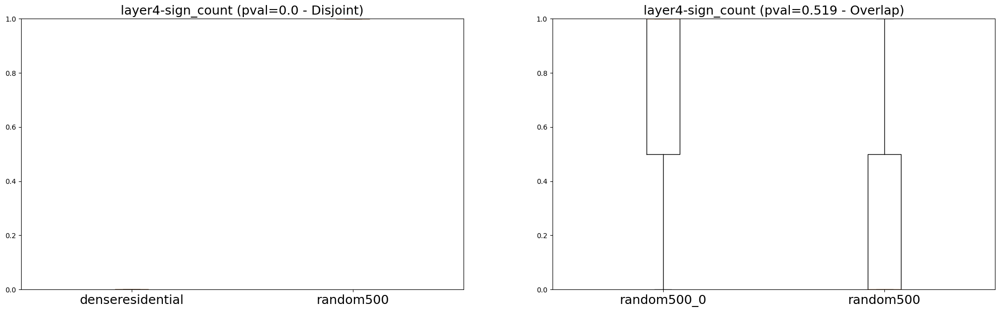

In [ ]:
# Display boxplots comparing TCAV scores for denseresidential concept and the random concepts for "layer4"
show_boxplots (tcav_scores_denseresidential, experimental_set_denseresidential, "layer4")

### Freeway Concept

#### Calculation of TCAV Scores

In [ ]:
# Define experimental set pairing target concepts with random concepts to test significance

experimental_set_freeway = [
    [freeway_concept, random_0_concept],
    [freeway_concept, random_1_concept],
    [freeway_concept, random_2_concept],
    [random_0_concept, random_1_concept],
    [random_0_concept, random_2_concept],
    [random_0_concept, random_3_concept]
    ]


In [ ]:
# TCAV score calculation to test the significance of the denseresidential concept
# Define layers for extracting Concept Activation Vectors (CAVs)
layer = ["layer1", "layer2", "layer3", "layer4"]

# Set up TCAV
mytcav_freeway = TCAV(model=model_loaded,
              layers=layer,
              layer_attr_method=LayerIntegratedGradients(model_loaded, None, multiply_by_inputs=False))


/usr/local/lib/python3.10/dist-packages/captum/concept/_utils/classifier.py:130: UserWarning: Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class
  warnings.warn(


In [ ]:
# Calculate TCAV scores for the freeway concept
tcav_scores_freeway = mytcav_freeway.interpret(inputs=wildfire_tensors,
                                        experimental_sets=experimental_set_freeway,
                                        target=wildfire_ind,
                                        n_steps=8,
                                       )
# Print the computed TCAV scores
print(tcav_scores_freeway)

/usr/local/lib/python3.10/dist-packages/captum/concept/_core/cav.py:165: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  save_dict = torch.load(cavs_path)
/usr/local/lib/pytho

defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x7af8381faa70>, {'2-3': defaultdict(None, {'layer1': {'sign_count': tensor([1., 0.]), 'magnitude': tensor([ 0.4263, -0.4263])}, 'layer2': {'sign_count': tensor([0.6500, 0.3500]), 'magnitude': tensor([ 0.0219, -0.0219])}, 'layer3': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0879,  0.0879])}, 'layer4': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0255,  0.0255])}}), '2-4': defaultdict(None, {'layer1': {'sign_count': tensor([0.9880, 0.0120]), 'magnitude': tensor([ 0.2957, -0.2957])}, 'layer2': {'sign_count': tensor([0.7940, 0.2060]), 'magnitude': tensor([ 0.0696, -0.0696])}, 'layer3': {'sign_count': tensor([0.2940, 0.7060]), 'magnitude': tensor([-0.0190,  0.0190])}, 'layer4': {'sign_count': tensor([1., 0.]), 'magnitude': tensor([ 0.0006, -0.0006])}}), '2-5': defaultdict(None, {'layer1': {'sign_count': tensor([0.9900, 0.0100]), 'magnitude': tensor([ 0.3201, -0.3201])}, 'layer2': {'sign_count': tensor([0.37

Concept: freeway
Values: [1.0, 0.65, 0.0, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.0, 0.35, 1.0, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: freeway
Values: [0.988, 0.794, 0.294, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [0.012, 0.206, 0.706, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: freeway
Values: [0.99, 0.378, 0.002, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_2
Values: [0.01, 0.622, 0.998, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.374, 0.83, 0.836, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [0.626, 0.17, 0.164, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.344, 0.47, 0.244, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_2
Values: [0.656, 0.53, 0.756, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept:

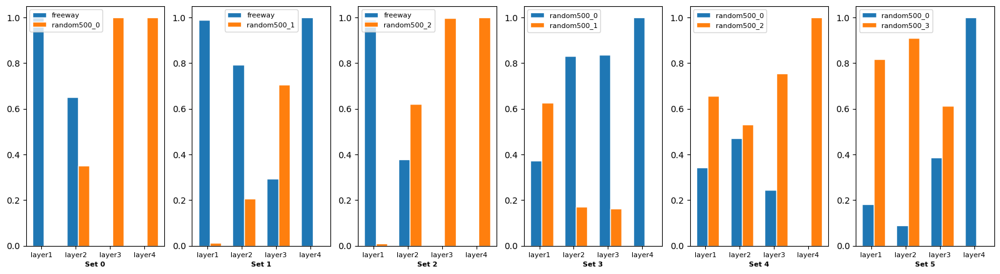

In [ ]:
# Plot TCAV scores for the freeway concept
plot_tcav_scores(experimental_set_freeway, tcav_scores_freeway, layer)

#### Significance Tests: Boxplots

esl: [[Concept(2, 'freeway'), Concept(3, 'random500_0')], [Concept(2, 'freeway'), Concept(4, 'random500_1')], [Concept(2, 'freeway'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


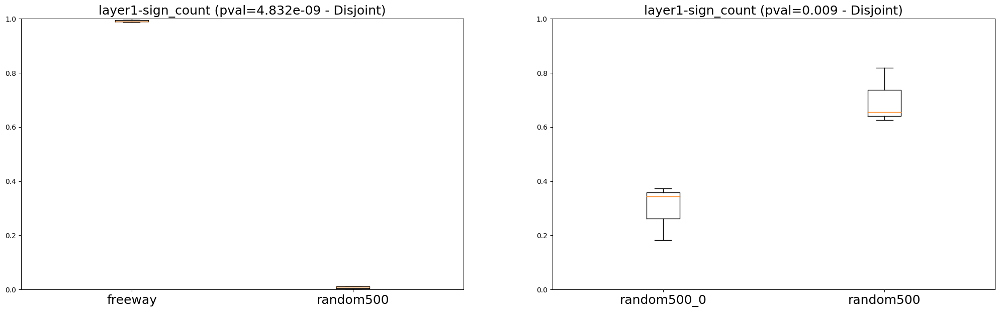

In [ ]:
# Display boxplots comparing TCAV scores for freeway concept and the random concepts for "layer1"
show_boxplots (tcav_scores_freeway, experimental_set_freeway, "layer1")

esl: [[Concept(2, 'freeway'), Concept(3, 'random500_0')], [Concept(2, 'freeway'), Concept(4, 'random500_1')], [Concept(2, 'freeway'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


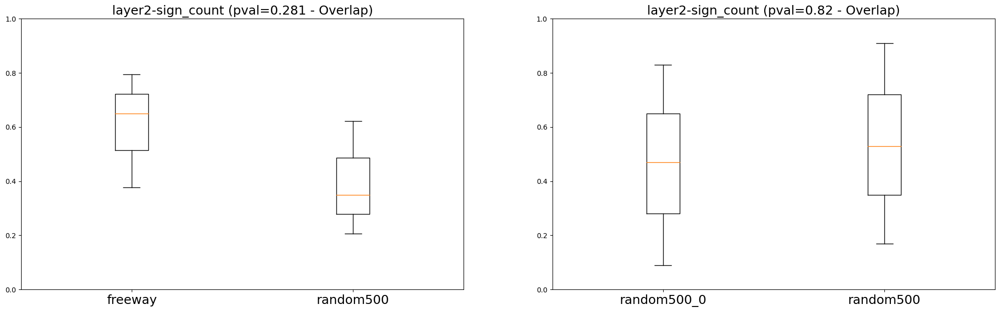

In [ ]:
# Display boxplots comparing TCAV scores for freeway concept and the random concepts for "layer2"
show_boxplots (tcav_scores_freeway, experimental_set_freeway, "layer2")

esl: [[Concept(2, 'freeway'), Concept(3, 'random500_0')], [Concept(2, 'freeway'), Concept(4, 'random500_1')], [Concept(2, 'freeway'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


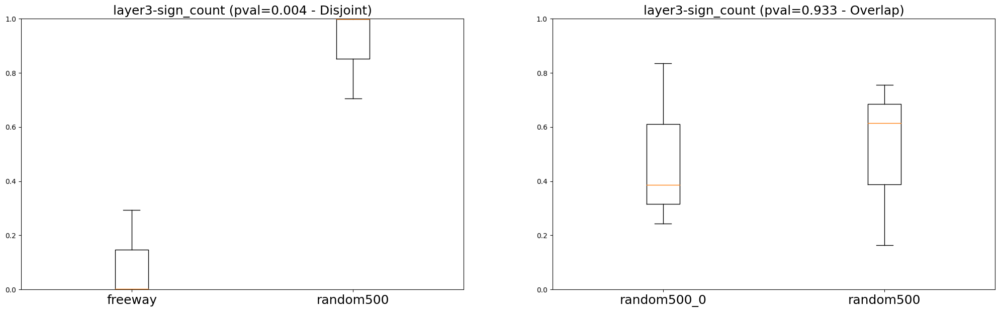

In [ ]:
# Display boxplots comparing TCAV scores for freeway concept and the random concepts for "layer3"
show_boxplots (tcav_scores_freeway, experimental_set_freeway, "layer3")

esl: [[Concept(2, 'freeway'), Concept(3, 'random500_0')], [Concept(2, 'freeway'), Concept(4, 'random500_1')], [Concept(2, 'freeway'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


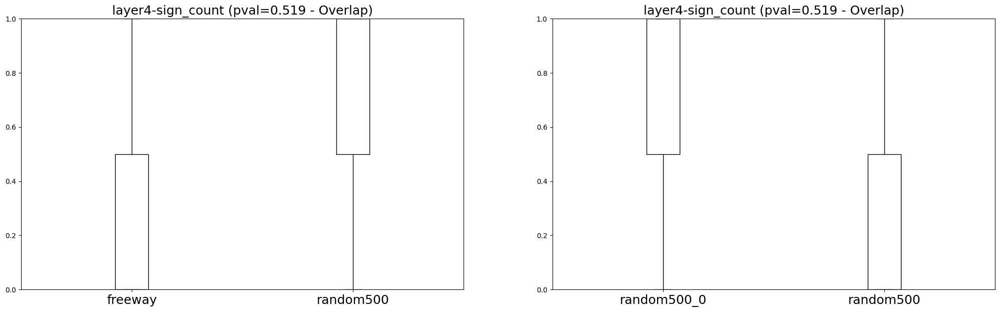

In [ ]:
# Display boxplots comparing TCAV scores for freeway concept and the random concepts for "layer4"
show_boxplots (tcav_scores_freeway, experimental_set_freeway, "layer4")

## Explanation Contrastiveness: TCAV Scores for the Opposite Class (Nowildfire)

In [ ]:
# TCAV score calculation for the "nowildire" class
# Define layers for extracting Concept Activation Vectors (CAVs)
layer = ["layer1", "layer2", "layer3", "layer4"]
#layer = ['layer1','layer4']

# Initialize TCAV with specified layers
mytcav_opposite = TCAV(model=model_loaded,
              layers=layer,
              layer_attr_method=LayerIntegratedGradients(model_loaded, None, multiply_by_inputs=False))

/usr/local/lib/python3.10/dist-packages/captum/concept/_utils/classifier.py:130: UserWarning: Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class
  warnings.warn(


In [ ]:
# Calculate TCAV scores a third time for the "nowildfire" class
tcav_scores_opposite = mytcav_opposite.interpret(inputs=wildfire_tensors,
                                        experimental_sets=experimental_set_concepts,
                                        target=nowildfire_ind,
                                        n_steps=8,
                                       )
# Print the computed TCAV scores
print(tcav_scores_opposite)

/usr/local/lib/python3.10/dist-packages/captum/concept/_core/cav.py:165: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  save_dict = torch.load(cavs_path)


defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x7af8513f36d0>, {'0-1-2': defaultdict(None, {'layer1': {'sign_count': tensor([0.7760, 0.2820, 0.1700]), 'magnitude': tensor([ 0.1442, -0.1021, -0.0702])}, 'layer2': {'sign_count': tensor([0.9980, 0.0200, 0.0980]), 'magnitude': tensor([ 0.2669, -0.1799, -0.0777])}, 'layer3': {'sign_count': tensor([0.5460, 0.5360, 0.9220]), 'magnitude': tensor([0.0005, 0.0017, 0.0397])}, 'layer4': {'sign_count': tensor([0., 1., 0.]), 'magnitude': tensor([-0.1415,  0.1240, -0.0151])}})})


Concept: forest
Values: [0.776, 0.998, 0.546, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: denseresidential
Values: [0.282, 0.02, 0.536, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: freeway
Values: [0.17, 0.098, 0.922, 0.0]
Type of val: <class 'list'>
Length of val: 4



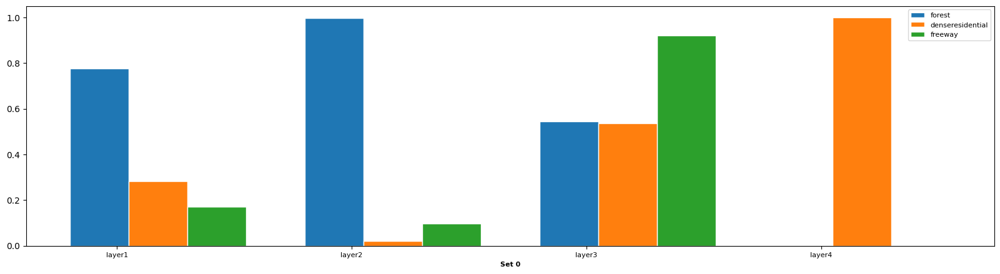

In [ ]:
# Plot TCAV scores for the calculation of the "nowildfire" class
plot_tcav_scores(experimental_set_concepts, tcav_scores_opposite, layer)

## Explanation Completeness: Concept Images as Model Input

In [ ]:
# Create a evaluation directory containing the test images of the concepts of interest and the unused random folders
! mkdir /content/evaluation

# Define source directories for the test images and unused random folders
concept_folders = {
    "forest_concept": "/content/concept-dataset/images_train_test_val/test/forest",
    "denseresidential_concept": "/content/concept-dataset/images_train_test_val/test/sparseresidential",
    "freeway_concept": "/content/concept-dataset/images_train_test_val/test/freeway",
    "random_3_concept": "/content/random/random500_3",
    "random_4_concept": "/content/random/random500_4"
}

# Define the destination directory for all concept images
destination_dir = "/content/evaluation"

# Copy each concept folder to the evaluation directory
for concept, src_dir in concept_folders.items():
  dest_dir = os.path.join(destination_dir, concept)

  if os.path.exists(dest_dir):
    print(f"Destination folder {dest_dir} already exists, skipping copy.")
  else:
    shutil.copytree(src_dir, dest_dir)  # Copy the entire folder
    print(f"Copied {concept} to {dest_dir}")

# Print completion message for validation
print(f"Copied all concept folders to {destination_dir}.")

Copied forest_concept to /content/evaluation/forest_concept
Copied denseresidential_concept to /content/evaluation/denseresidential_concept
Copied freeway_concept to /content/evaluation/freeway_concept
Copied random_3_concept to /content/evaluation/random_3_concept
Copied random_4_concept to /content/evaluation/random_4_concept
Copied all concept folders to /content/evaluation.


In [ ]:
# Use the concept images from the created evaluation direcotry as input to the wildfire classification model


# Define the directory containing the evaluation images of the concepts
evaluation_dir = "/content/evaluation"

model_loaded.eval()

# Prepare the test dataset and dataloader with transformations
concept_dataset_evaluation = datasets.ImageFolder(root=evaluation_dir, transform=data_transforms, loader=cv2_loader)
concept_loader_evaluation = DataLoader(concept_dataset_evaluation, batch_size=32, shuffle=False)

# Initialize a list to store classification results
results = []

# Create a mapping from folder names (concepts) to class indices
concept_class_mapping = {v: k for k, v in concept_dataset_evaluation.class_to_idx.items()}

# Iterate through the concept data loader
for inputs, labels in concept_loader_evaluation:
  inputs = inputs.to(device)  # Move inputs to the appropriate device (GPU/CPU)
  labels = labels.to(device)  # Move labels to the appropriate device

# Get model predictions
  outputs = model_loaded(inputs)
  _, preds = torch.max(outputs, 1)


  for i in range(inputs.size(0)):
    concept_label = concept_class_mapping[labels[i].item()]  # Get the original concept label (folder name)
    wildfire_classification = 'wildfire' if preds[i].item() == 1 else 'no wildfire'  # Assuming 1 is wildfire and 0 is no wildfire

    # Append the result to the list
    results.append({
        'concept': concept_label,
        'classification': wildfire_classification
    })

# Convert the results to a pandas DataFrame for analysis
evaluation_results_df = pd.DataFrame(results)

In [ ]:
# Display the first few rows of the results DataFrame
evaluation_results_df.head()

,concept,classification
0,denseresidential_concept,no wildfire
1,denseresidential_concept,no wildfire
2,denseresidential_concept,no wildfire
3,denseresidential_concept,wildfire
4,denseresidential_concept,no wildfire


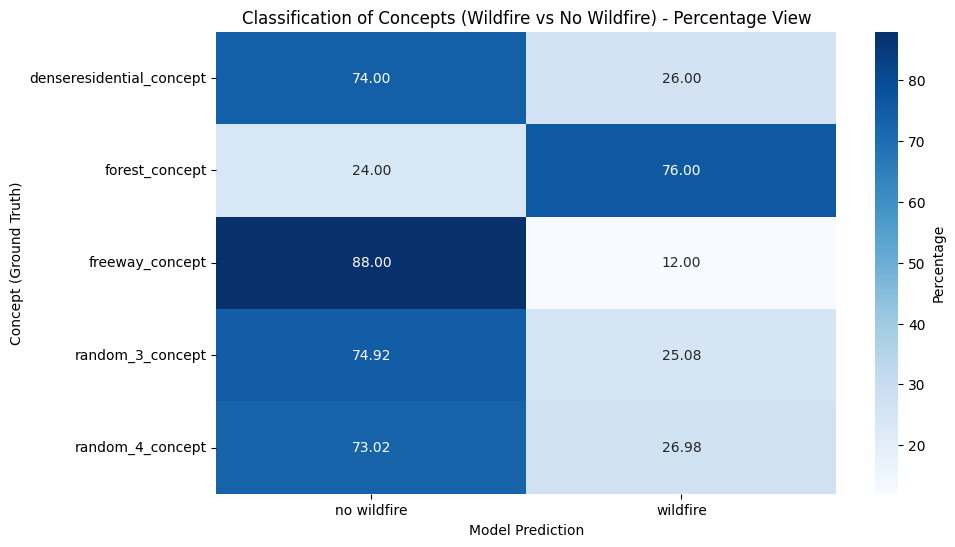

In [ ]:
# Create a confusion matrix-like pivot table from the results DataFrame
confusion_matrix_evaluation = pd.crosstab(evaluation_results_df['concept'], evaluation_results_df['classification'])

# Normalize the confusion matrix to display percentages and allow for easier comparison despite different image counts per concept
confusion_matrix_normalized = confusion_matrix_evaluation.div(confusion_matrix_evaluation.sum(axis=1), axis=0) * 100

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(confusion_matrix_normalized, annot=True, fmt=".2f", cmap="Blues", cbar_kws={'label': 'Percentage'})

plt.title("Classification of Concepts (Wildfire vs No Wildfire) - Percentage View")
plt.xlabel("Model Prediction")
plt.ylabel("Concept (Ground Truth)")

plt.show()

In [ ]:
# Use the test images of each concept as input to understand the result more clearly, following the same procedure

# Define the directory containing the test images of the concepts
concept_test_dir = "/content/concept-dataset/images_train_test_val/test"

model_loaded.eval()

# Prepare the test dataset and dataloader with transformations
concept_dataset_tests = datasets.ImageFolder(root=concept_test_dir, transform=data_transforms, loader=cv2_loader)
concept_loader_tests = DataLoader(concept_dataset_tests, batch_size=32, shuffle=False)

# Initialize a list to store classification results
results = []

# Create a mapping from folder names (concepts) to class indices
concept_class_mapping = {v: k for k, v in concept_dataset_tests.class_to_idx.items()}

# Iterate through the data loader
for inputs, labels in concept_loader_tests:
  inputs = inputs.to(device)
  labels = labels.to(device)

  # Get model predictions
  outputs = model_loaded(inputs)
  _, preds = torch.max(outputs, 1)

  for i in range(inputs.size(0)):
    concept_label = concept_class_mapping[labels[i].item()]
    wildfire_classification = "wildfire" if preds[i].item() == 1 else "no wildfire"

    # Append the result to the list
    results.append({
        "concept": concept_label,
        "classification": wildfire_classification
    })

# Convert the results to a pandas DataFrame for analysis
results_df = pd.DataFrame(results)

In [ ]:
# Display the first few rows of the results DataFrame
results_df.head()

,concept,classification
0,agricultural,no wildfire
1,agricultural,no wildfire
2,agricultural,no wildfire
3,agricultural,no wildfire
4,agricultural,wildfire


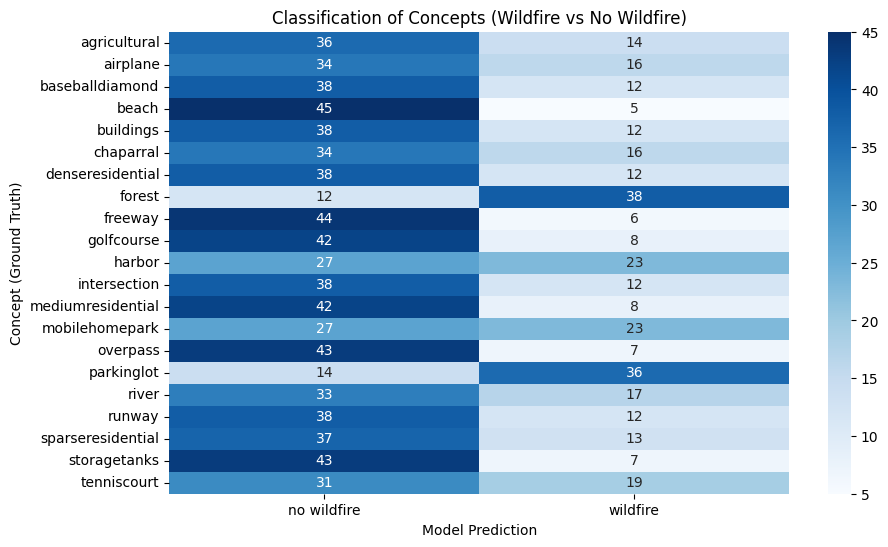

In [ ]:
# Create a confusion matrix-like pivot table from the results DataFrame
confusion_matrix_data = pd.crosstab(results_df["concept"], results_df["classification"])

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(confusion_matrix_data, annot=True, fmt="d", cmap="Blues")

plt.title("Classification of Concepts (Wildfire vs No Wildfire)")
plt.xlabel("Model Prediction")
plt.ylabel("Concept (Ground Truth)")

plt.show()